In [51]:
from pyedflib import highlevel
import pyedflib as plib
import numpy as np
import matplotlib.pyplot as plt
import mne

In [52]:
raw = mne.io.read_raw_edf("/Users/archita/osa-ubc/edf-analysis/data/highAHI/OSAA10002_New.edf", preload=True)
edf_start = raw.info["meas_date"].replace(tzinfo=None)
print(f"EDF Start: {edf_start}")

Extracting EDF parameters from /Users/archita/osa-ubc/edf-analysis/data/highAHI/OSAA10002_New.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 6951935  =      0.000 ... 27155.996 secs...
EDF Start: 2016-08-15 22:14:53


In [53]:
raw.ch_names

['Airflow',
 'RIBCAGE',
 'ABDOMEN',
 'Snore#1',
 'Nasal Pressure /',
 'Sum Effort',
 'BiNaps Nasal Pre',
 'M1',
 'M2',
 'C3',
 'C4',
 'O1',
 'O2',
 'LOC',
 'ROC',
 'F3',
 'F4',
 'EMG1',
 'EMG2',
 'EMG3',
 'ECG1',
 'ECG2',
 'L-ARM',
 'R-ARM',
 'L-Leg1',
 'R-Leg1',
 'L-Leg2',
 'R-Leg2',
 'SaO2',
 'Pulse',
 'NASAL PRES.',
 'TcpCO2',
 'C-Flow',
 'C-Leak',
 'C-Pressure']

In [84]:
import numpy as np
import mne
from mne import create_info

# Step 1: Select channels
eeg_channels = ['C3', 'C4']
ref_channels = ['M1', 'M2']
other_channels = ['Airflow']

# Pick required channels
raw_eeg = raw.copy().pick_channels(eeg_channels + ref_channels + other_channels)

# Step 2: Get data
data = raw_eeg.get_data()  # shape = (n_channels, n_samples)
channel_names = raw_eeg.ch_names
sfreq = raw_eeg.info['sfreq']

# Step 3: Find indices for C3, C4, M1, M2
idx_c3 = channel_names.index('C3')
idx_c4 = channel_names.index('C4')
idx_m1 = channel_names.index('M1')
idx_m2 = channel_names.index('M2')
idx_airflow = channel_names.index('Airflow')

# Step 4: Compute referenced EEG signals
diff_c3_m2 = data[idx_c3] - data[idx_m2]
diff_c4_m1 = data[idx_c4] - data[idx_m1]
airflow = data[idx_airflow]

# Step 5: Combine data
combined_data = np.vstack([diff_c3_m2, diff_c4_m1, airflow])

# Step 6: Create new info and Raw object
new_channel_names = ['EEG_C3-M2', 'EEG_C4-M1', 'Airflow']
new_channel_types = ['eeg', 'eeg', 'misc']  # Airflow is not EEG
info = create_info(new_channel_names, sfreq=sfreq, ch_types=new_channel_types)
new_raw = mne.io.RawArray(combined_data, info)
new_raw_nan = mne.io.RawArray(combined_data, info)



NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Creating RawArray with float64 data, n_channels=3, n_times=6951936
    Range : 0 ... 6951935 =      0.000 ... 27155.996 secs
Ready.
Creating RawArray with float64 data, n_channels=3, n_times=6951936
    Range : 0 ... 6951935 =      0.000 ... 27155.996 secs
Ready.


In [55]:
new_raw

<RawArray | 3 x 6951936 (27156.0 s), ~159.1 MiB, data loaded>

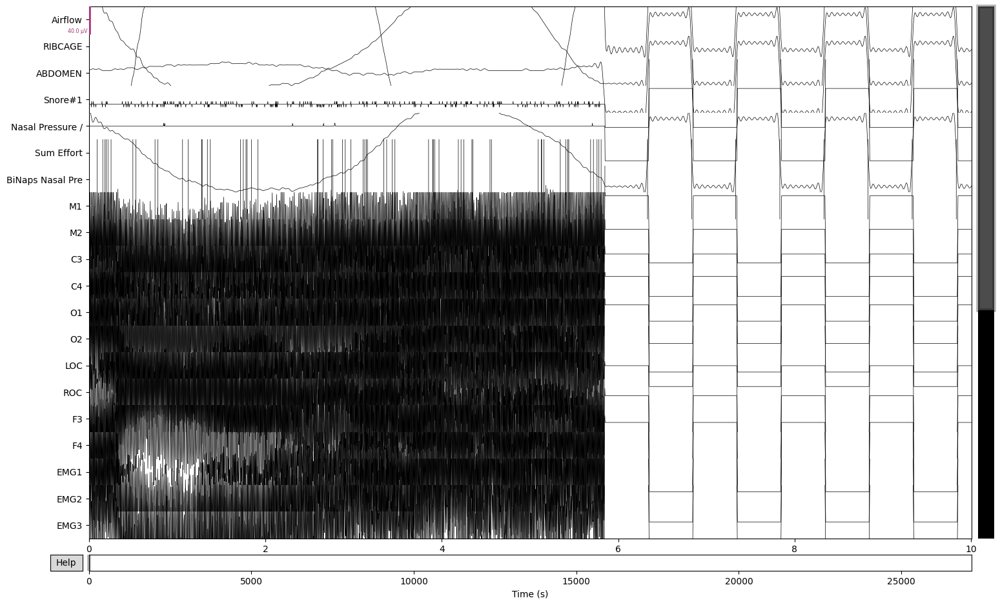

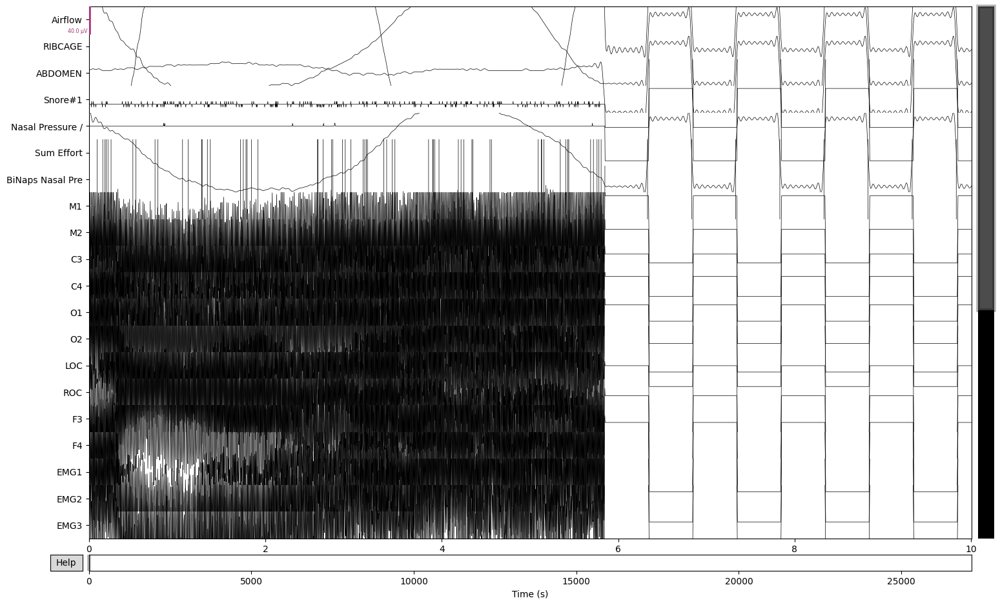

In [56]:
raw.plot()

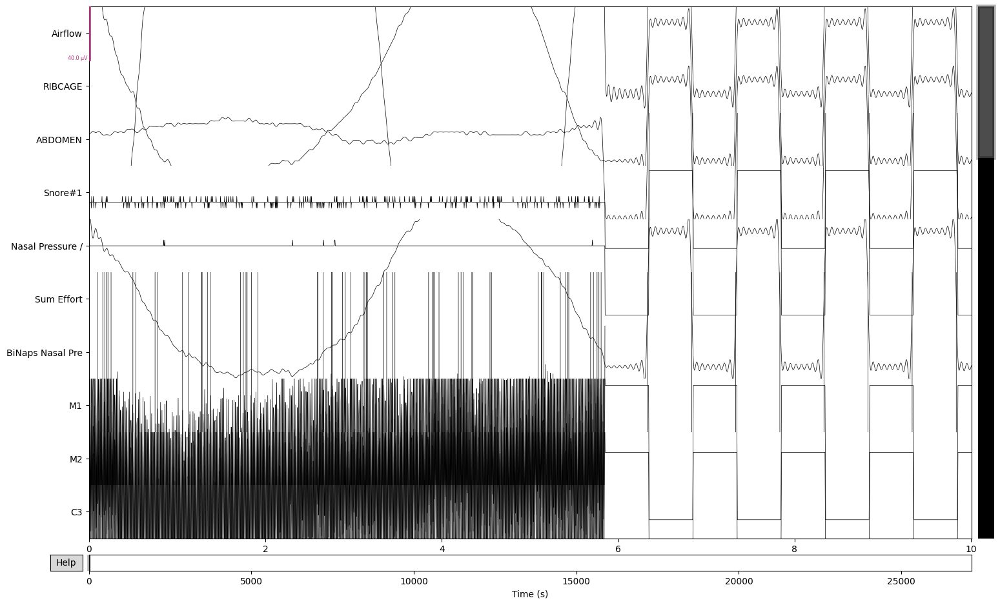

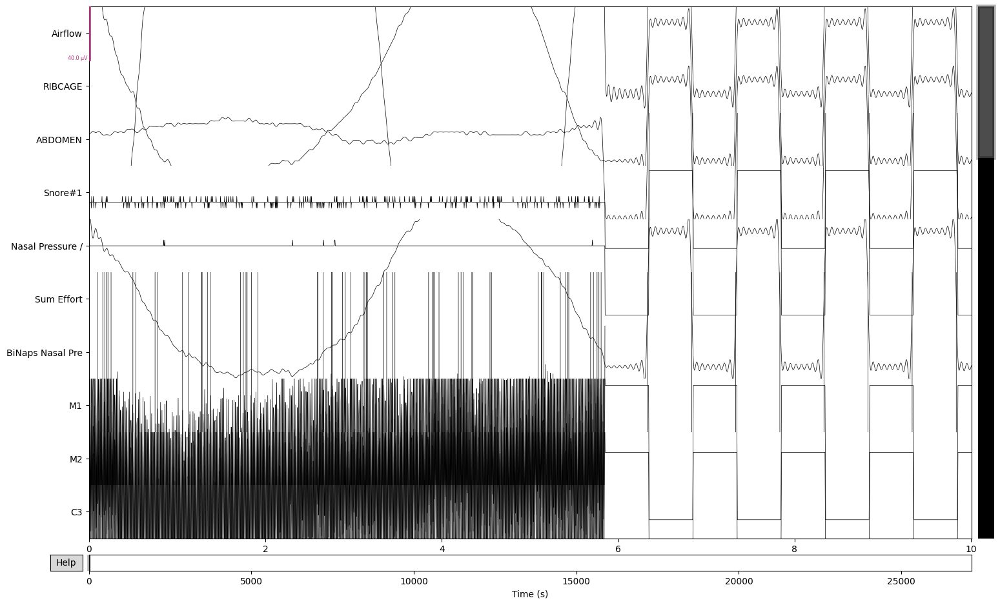

In [57]:
raw.plot(n_channels=10)

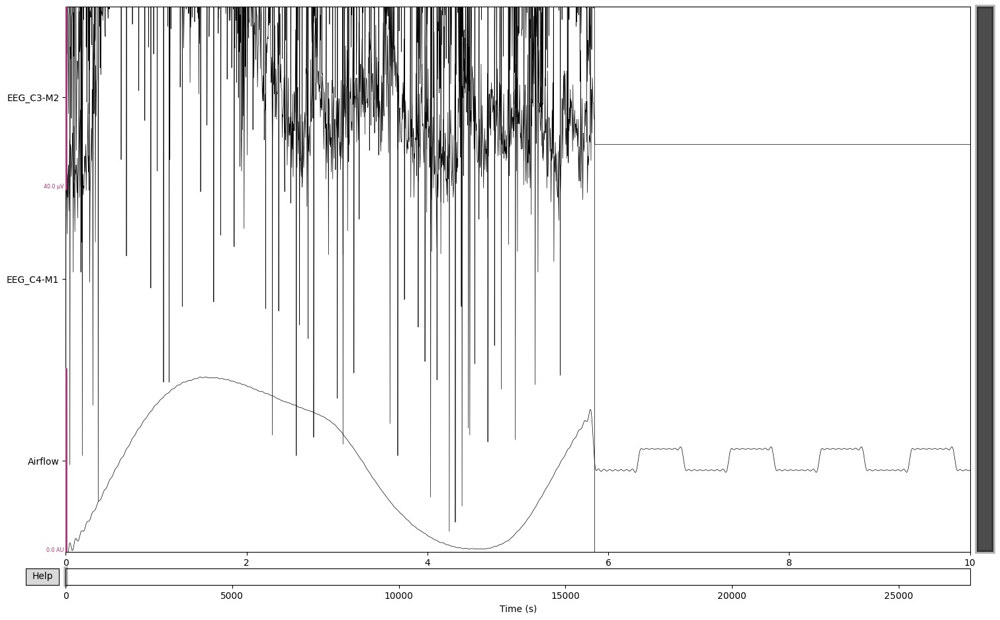

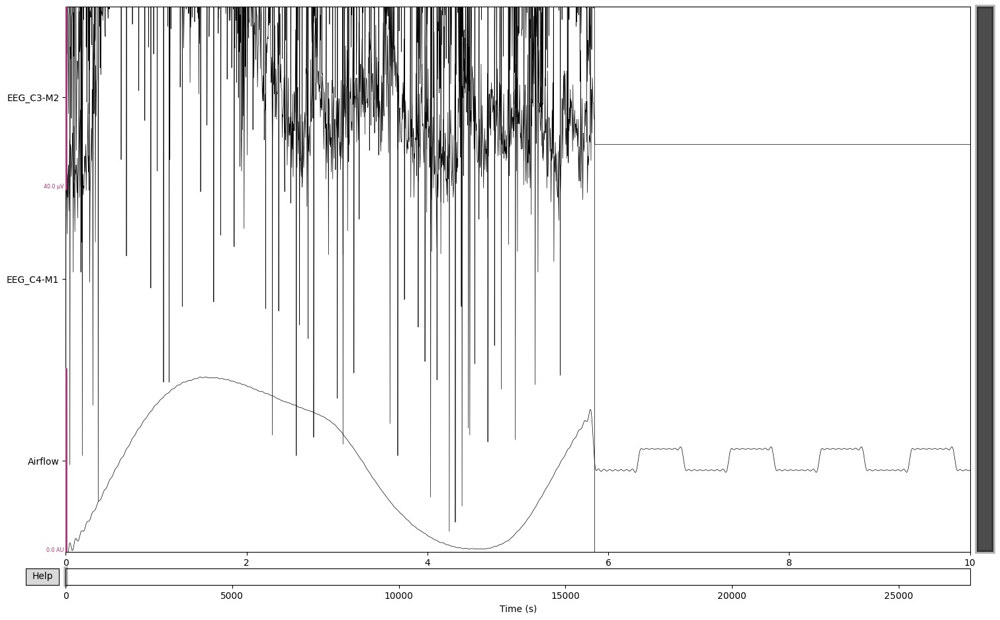

In [58]:
new_raw.plot()

In [70]:
import pandas as pd
from datetime import datetime

# Load your file (adjust delimiter if it's a CSV/TSV)
df = pd.read_csv("data/highAHI/OSAA10002 epoch and event list copy.txt", sep="\t")  # or use ',' or other delimiter

# Parse times to datetime objects
def parse_time(t):
    return datetime.strptime(t.strip(), "%I:%M:%S %p")  # Handles 12-hour format

df = df[df["Epoch"] >= 17].reset_index(drop=True)  # Keep from row 17 onward
df["parsed_time"] = df["Start Time"].apply(parse_time)

In [71]:
df[:50]

,Epoch,Event,Start Time,Duration,parsed_time
0,17,Wake,10:22:53 PM,1170.00,1900-01-01 22:22:53
1,17,Lights Off,10:23:03 PM,26646.10,1900-01-01 22:23:03
2,17,Left,10:23:17 PM,933.35,1900-01-01 22:23:17
3,18,Wake,10:23:23 PM,NaN,1900-01-01 22:23:23
4,19,Wake,10:23:53 PM,NaN,1900-01-01 22:23:53
5,20,Wake,10:24:23 PM,NaN,1900-01-01 22:24:23
6,21,Wake,10:24:53 PM,NaN,1900-01-01 22:24:53
7,22,Wake,10:25:23 PM,NaN,1900-01-01 22:25:23
8,23,Wake,10:25:53 PM,NaN,1900-01-01 22:25:53
9,24,Wake,10:26:23 PM,NaN,1900-01-01 22:26:23


In [68]:
df_nan = df.dropna(subset=["Duration"])   
df_nan[:50]

,Epoch,Event,Start Time,Duration,parsed_time
0,17,Wake,10:22:53 PM,1170.00,1900-01-01 22:22:53
1,17,Lights Off,10:23:03 PM,26646.10,1900-01-01 22:23:03
2,17,Left,10:23:17 PM,933.35,1900-01-01 22:23:17
35,48,Right,10:38:50 PM,2031.84,1900-01-01 22:38:50
43,56,Stage 1,10:42:23 PM,60.00,1900-01-01 22:42:23
45,58,Wake,10:43:23 PM,780.00,1900-01-01 22:43:23
71,84,Stage 1,10:56:23 PM,90.00,1900-01-01 22:56:23
72,84,Both Legs w/ Arousal,10:56:29 PM,3.48,1900-01-01 22:56:29
73,84,Arousal w/ PLM,10:56:31 PM,3.72,1900-01-01 22:56:31
74,84,Both Legs,10:56:43 PM,1.72,1900-01-01 22:56:43


In [72]:
df.Event.value_counts()

Event
Wake                                  462
Stage 2                               324
Both Legs                             238
Arousal w/ PLM                        108
Both Legs w/ Arousal                  108
Rem                                    70
Desaturation w/ Respiratory            41
Hypopnea                               37
Stage 1                                34
Arousal                                22
Hypopnea w/ Arousal                    20
Arousal w/ Respiratory                 20
Desaturation                           17
Supine                                  9
Left                                    8
Right                                   4
Bad Data (Channel SpO2  (Amp 1))        3
Bathroom Out                            3
Bathroom In                             2
can't relax legs are bothering him      1
Upright                                 1
Lights Off                              1
Lights On                               1
wants to get up             

In [73]:
# Set base annotation time from first row (row 17)
base_annotation_time = df.loc[0, "parsed_time"]
base_annotation_time

Timestamp('1900-01-01 22:22:53')

Computing the time offset (in seconds) between:

- The start of the EEG recording (edf_start)
- The first annotation timestamp (10:22:53 PM), which is stored in the first row of your annotation file (Epoch 17)

In [74]:
# === Compute base_annotation_time and time offset ===
annotation_base_time = df.loc[0, "parsed_time"].time()
annotation_base_datetime = datetime.combine(edf_start.date(), annotation_base_time)
time_offset_sec = (annotation_base_datetime - edf_start).total_seconds()

print(f"Time offset from EDF start to annotation start: {time_offset_sec} seconds")

Time offset from EDF start to annotation start: 480.0 seconds


In [75]:
annotation_base_datetime = datetime.combine(edf_start.date(), annotation_base_time)
edf_start, annotation_base_datetime

(datetime.datetime(2016, 8, 15, 22, 14, 53),
 datetime.datetime(2016, 8, 15, 22, 22, 53))

In [77]:
sleeping_stages = ["Wake", "Stage 1", "Stage 2", "Stage 3", "Rem"]
df_sleeping_stages = df[df["Event"].isin(sleeping_stages)].reset_index(drop=True)
df_sleeping_stages_nan = df_nan[df_nan["Event"].isin(sleeping_stages)].reset_index(drop=True)

In [79]:
df_sleeping_stages

,Epoch,Event,Start Time,Duration,parsed_time
0,17,Wake,10:22:53 PM,1170.0,1900-01-01 22:22:53
1,18,Wake,10:23:23 PM,NaN,1900-01-01 22:23:23
2,19,Wake,10:23:53 PM,NaN,1900-01-01 22:23:53
3,20,Wake,10:24:23 PM,NaN,1900-01-01 22:24:23
4,21,Wake,10:24:53 PM,NaN,1900-01-01 22:24:53
...,...,...,...,...,...
885,902,Wake,5:45:23 AM,NaN,1900-01-01 05:45:23
886,903,Wake,5:45:53 AM,NaN,1900-01-01 05:45:53
887,904,Wake,5:46:23 AM,NaN,1900-01-01 05:46:23
888,905,Wake,5:46:53 AM,NaN,1900-01-01 05:46:53


In [78]:
df_sleeping_stages_nan

,Epoch,Event,Start Time,Duration,parsed_time
0,17,Wake,10:22:53 PM,1170.0,1900-01-01 22:22:53
1,56,Stage 1,10:42:23 PM,60.0,1900-01-01 22:42:23
2,58,Wake,10:43:23 PM,780.0,1900-01-01 22:43:23
3,84,Stage 1,10:56:23 PM,90.0,1900-01-01 22:56:23
4,87,Stage 2,10:57:53 PM,660.0,1900-01-01 22:57:53
5,109,Wake,11:08:53 PM,3660.0,1900-01-01 23:08:53
6,231,Stage 1,12:09:53 AM,30.0,1900-01-01 00:09:53
7,232,Stage 2,12:10:23 AM,30.0,1900-01-01 00:10:23
8,233,Stage 1,12:10:53 AM,30.0,1900-01-01 00:10:53
9,234,Stage 2,12:11:23 AM,180.0,1900-01-01 00:11:23


In [81]:
df_hypopnea = df[df["Event"].str.contains("Hypopnea", na=False)].reset_index(drop=True)
df_hypopnea_nan = df_nan[df_nan["Event"].str.contains("Hypopnea", na=False)].reset_index(drop=True)

In [82]:
df_hypopnea

,Epoch,Event,Start Time,Duration,parsed_time
0,89,Hypopnea w/ Arousal,10:59:02 PM,24.47,1900-01-01 22:59:02
1,306,Hypopnea w/ Arousal,12:47:31 AM,14.32,1900-01-01 00:47:31
2,308,Hypopnea w/ Arousal,12:48:47 AM,9.28,1900-01-01 00:48:47
3,310,Hypopnea w/ Arousal,12:49:24 AM,13.80,1900-01-01 00:49:24
4,312,Hypopnea w/ Arousal,12:50:29 AM,13.39,1900-01-01 00:50:29
5,450,Hypopnea w/ Arousal,1:59:52 AM,12.64,1900-01-01 01:59:52
6,454,Hypopnea,2:01:41 AM,20.96,1900-01-01 02:01:41
7,480,Hypopnea,2:14:36 AM,11.12,1900-01-01 02:14:36
8,481,Hypopnea,2:15:09 AM,37.23,1900-01-01 02:15:09
9,528,Hypopnea w/ Arousal,2:38:26 AM,28.65,1900-01-01 02:38:26


In [83]:
df_hypopnea_nan

,Epoch,Event,Start Time,Duration,parsed_time
0,89,Hypopnea w/ Arousal,10:59:02 PM,24.47,1900-01-01 22:59:02
1,306,Hypopnea w/ Arousal,12:47:31 AM,14.32,1900-01-01 00:47:31
2,308,Hypopnea w/ Arousal,12:48:47 AM,9.28,1900-01-01 00:48:47
3,310,Hypopnea w/ Arousal,12:49:24 AM,13.80,1900-01-01 00:49:24
4,312,Hypopnea w/ Arousal,12:50:29 AM,13.39,1900-01-01 00:50:29
5,450,Hypopnea w/ Arousal,1:59:52 AM,12.64,1900-01-01 01:59:52
6,454,Hypopnea,2:01:41 AM,20.96,1900-01-01 02:01:41
7,480,Hypopnea,2:14:36 AM,11.12,1900-01-01 02:14:36
8,481,Hypopnea,2:15:09 AM,37.23,1900-01-01 02:15:09
9,528,Hypopnea w/ Arousal,2:38:26 AM,28.65,1900-01-01 02:38:26


In [85]:
from datetime import datetime, timedelta

def create_annotations_fixed(df_events, edf_start, annotation_base_datetime, time_offset_sec):
    onsets = [] # 	Start Time
    durations = [] # 	Duration
    descriptions = [] # Event

    for _, row in df_events.iterrows():
        current_time = row["parsed_time"].time()
        current_datetime = datetime.combine(edf_start.date(), current_time)
        
        # If the annotation time is before the base annotation time, add a day
        if current_time < annotation_base_datetime.time():
            current_datetime += timedelta(days=1)
        
        onset_sec = (current_datetime - annotation_base_datetime).total_seconds() + time_offset_sec
        
        # set as 30 seconds
        duration_sec = float(row["Duration"]) if not pd.isna(row["Duration"]) else 30.0
       
        onsets.append(onset_sec)
        durations.append(duration_sec)
        descriptions.append(row["Event"])
    return onsets, durations, descriptions

# --- Create annotations with the fixed function ---
onsets_sleep, durations_sleep, descriptions_sleep = create_annotations_fixed(
    df_sleeping_stages, edf_start, annotation_base_datetime, time_offset_sec
)

onsets_hyp, durations_hyp, descriptions_hyp = create_annotations_fixed(
    df_hypopnea, edf_start, annotation_base_datetime, time_offset_sec
)

# --- Combine all annotations ---
all_onsets = onsets_sleep + onsets_hyp
all_durations = durations_sleep + durations_hyp
all_descriptions = descriptions_sleep + descriptions_hyp


# --- Add combined annotations to your Raw object ---
annotations = mne.Annotations(onset=all_onsets, duration=all_durations, description=all_descriptions)
new_raw.set_annotations(annotations)

# --- Create annotations with the fixed function ---
onsets_sleep_nan, durations_sleep_nan, descriptions_sleep_nan = create_annotations_fixed(
    df_sleeping_stages_nan, edf_start, annotation_base_datetime, time_offset_sec
)

onsets_hyp_nan, durations_hyp_nan, descriptions_hyp_nan = create_annotations_fixed(
    df_hypopnea_nan, edf_start, annotation_base_datetime, time_offset_sec
)

# --- Combine all annotations ---
all_onsets_nan = onsets_sleep_nan + onsets_hyp_nan
all_durations_nan = durations_sleep_nan + durations_hyp_nan
all_descriptions_nan = descriptions_sleep_nan + descriptions_hyp_nan


# --- Add combined annotations to your Raw object ---
annotations_nan = mne.Annotations(onset=all_onsets_nan, duration=all_durations_nan, description=all_descriptions_nan)
new_raw_nan.set_annotations(annotations_nan)

/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3517801310.py:43: RuntimeWarning: Limited 2 annotation(s) that were expanding outside the data range.
  new_raw.set_annotations(annotations)
/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3517801310.py:62: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  new_raw_nan.set_annotations(annotations_nan)


<RawArray | 3 x 6951936 (27156.0 s), ~159.1 MiB, data loaded>

In [86]:
for i, (onset, desc, duration) in enumerate(zip(new_raw.annotations.onset, new_raw.annotations.description,new_raw.annotations.duration)):
    if desc in ['Hypopnea','Wake','Stage 1', 'Stage 2', 'Stage 3', 'Rem']:
        print(f"{desc} at {onset:.1f}s for {duration}s ")

Wake at 480.0s for 1170.0s 
Wake at 510.0s for 30.0s 
Wake at 540.0s for 30.0s 
Wake at 570.0s for 30.0s 
Wake at 600.0s for 30.0s 
Wake at 630.0s for 30.0s 
Wake at 660.0s for 30.0s 
Wake at 690.0s for 30.0s 
Wake at 720.0s for 30.0s 
Wake at 750.0s for 30.0s 
Wake at 780.0s for 30.0s 
Wake at 810.0s for 30.0s 
Wake at 840.0s for 30.0s 
Wake at 870.0s for 30.0s 
Wake at 900.0s for 30.0s 
Wake at 930.0s for 30.0s 
Wake at 960.0s for 30.0s 
Wake at 990.0s for 30.0s 
Wake at 1020.0s for 30.0s 
Wake at 1050.0s for 30.0s 
Wake at 1080.0s for 30.0s 
Wake at 1110.0s for 30.0s 
Wake at 1140.0s for 30.0s 
Wake at 1170.0s for 30.0s 
Wake at 1200.0s for 30.0s 
Wake at 1230.0s for 30.0s 
Wake at 1260.0s for 30.0s 
Wake at 1290.0s for 30.0s 
Wake at 1320.0s for 30.0s 
Wake at 1350.0s for 30.0s 
Wake at 1380.0s for 30.0s 
Wake at 1410.0s for 30.0s 
Wake at 1440.0s for 30.0s 
Wake at 1470.0s for 30.0s 
Wake at 1500.0s for 30.0s 
Wake at 1530.0s for 30.0s 
Wake at 1560.0s for 30.0s 
Wake at 1590.0s f

In [94]:
for i, (onset, desc, duration) in enumerate(zip(new_raw_nan.annotations.onset, new_raw_nan.annotations.description, new_raw_nan.annotations.duration)):
    print(f"{desc} at {onset:.1f}s for {duration}s ")

Wake at 480.0s for 1170.0s 
Stage 1 at 1650.0s for 60.0s 
Wake at 1710.0s for 780.0s 
Stage 1 at 2490.0s for 90.0s 
Stage 2 at 2580.0s for 660.0s 
Hypopnea w/ Arousal at 2649.0s for 24.47s 
Wake at 3240.0s for 3660.0s 
Stage 1 at 6900.0s for 30.0s 
Stage 2 at 6930.0s for 30.0s 
Stage 1 at 6960.0s for 30.0s 
Stage 2 at 6990.0s for 180.0s 
Wake at 7170.0s for 90.0s 
Stage 1 at 7260.0s for 60.0s 
Stage 2 at 7320.0s for 660.0s 
Wake at 7980.0s for 1170.0s 
Stage 1 at 9150.0s for 60.0s 
Hypopnea w/ Arousal at 9158.0s for 14.32s 
Stage 2 at 9210.0s for 90.0s 
Hypopnea w/ Arousal at 9234.0s for 9.28s 
Hypopnea w/ Arousal at 9271.0s for 13.8s 
Wake at 9300.0s for 30.0s 
Stage 1 at 9330.0s for 30.0s 
Hypopnea w/ Arousal at 9336.0s for 13.39s 
Wake at 9360.0s for 30.0s 
Stage 1 at 9390.0s for 30.0s 
Wake at 9420.0s for 4050.0s 
Stage 1 at 13470.0s for 60.0s 
Hypopnea w/ Arousal at 13499.0s for 12.64s 
Stage 2 at 13530.0s for 780.0s 
Hypopnea at 13608.0s for 20.96s 
Wake at 14310.0s for 30.0s 
St

In [127]:
9420.0 + 4050.0

13470.0

In [91]:
# # Show annotations in a specific time window

# def annotation_window_time(start_window, duration):
#     end_window = start_window + duration
#     print("Annotations in time window:", start_window, "to", end_window, "seconds:")
#     for i, (onset, duration, desc) in enumerate(zip(new_raw.annotations.onset, 
#                                                 new_raw.annotations.duration,
#                                                 new_raw.annotations.description)):
#         if start_window <= onset <= end_window:
#             print(f"{i:3d}: {onset:7.1f}s - {onset+duration:7.1f}s ({duration:5.1f}s) {desc}")

# start_window = 480
# end_window = 780
# duration = 300

# annotation_window_time(start_window, duration)

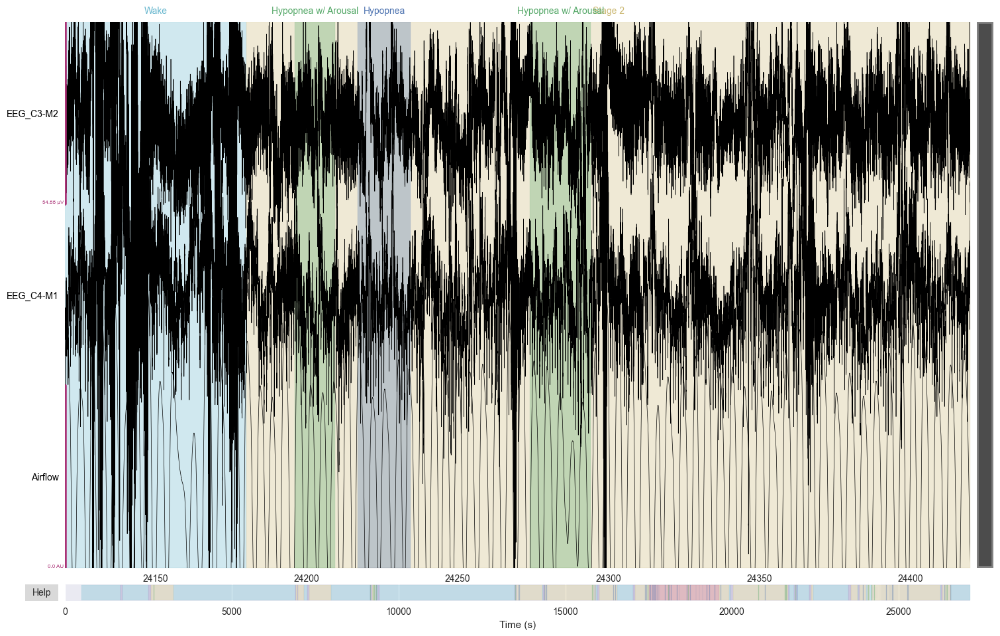

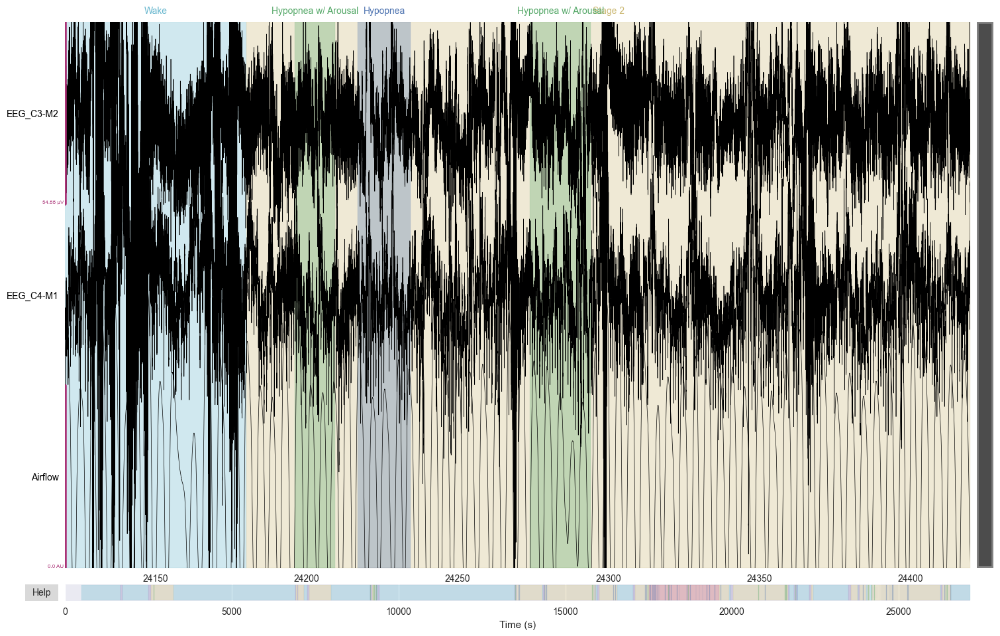

In [92]:
import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8')  # or 'ggplot', 'bmh'

# Then plot
new_raw_nan.plot(start=24120, duration=300, n_channels=3, scalings='auto')

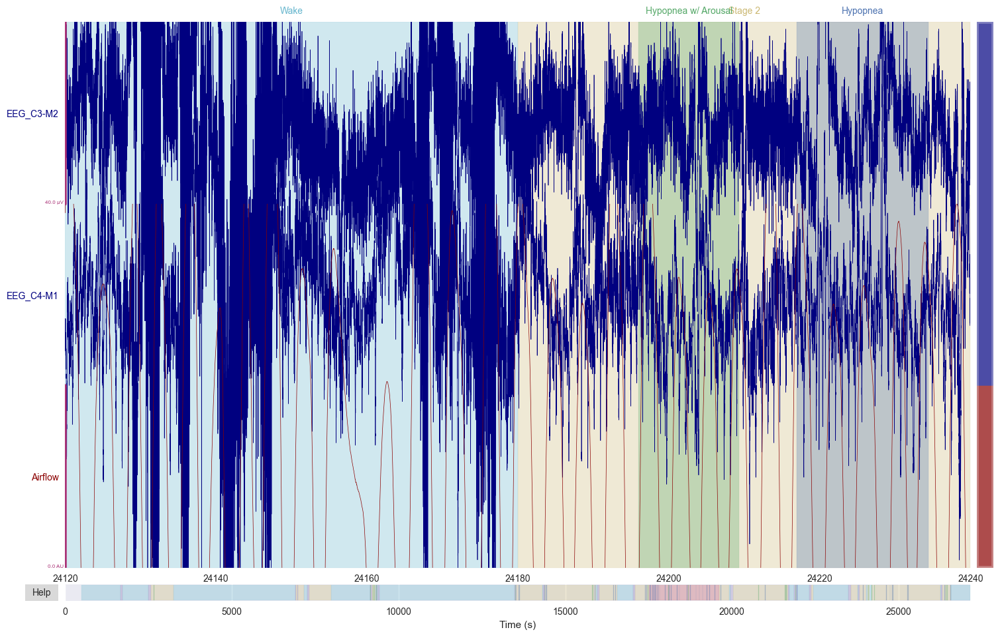

In [102]:
# Immediate improvement - just change these parameters:
fig = new_raw_nan.plot(
    start=24120,
    duration=120,  # Shorter window
    n_channels=3,
    scalings={'eeg': 2e-5, 'misc': 2e-4},  # Much smaller scaling
    title='EEG Data - Improved',
    show_scrollbars=True,  # Enable navigation
    block=False,
    bgcolor='white',
    color={'eeg': 'navy', 'misc': 'darkred'},
)

In [107]:
times = np.arange(duration_samples) / new_raw_nan.info['sfreq'] + start_time
times

array([24000.        , 24000.00390625, 24000.0078125 , ...,
       24499.98828125, 24499.9921875 , 24499.99609375])

In [111]:
data

array([[6.06060606e-06, 1.11111111e-05, 8.58585859e-06, ...,
        9.59595960e-06, 6.06060606e-06, 8.08080808e-06],
       [1.11111111e-05, 1.31313131e-05, 1.26262626e-05, ...,
        9.59595960e-06, 1.06060606e-05, 1.41414141e-05],
       [7.12500000e-04, 7.12334548e-04, 7.12163226e-04, ...,
        5.95313212e-04, 5.94881044e-04, 5.94352002e-04]])

In [109]:
plot_data = data[ch_idx, :] * 1e6
plot_data

array([11.11111111, 13.13131313, 12.62626263, ...,  9.5959596 ,
       10.60606061, 14.14141414])

In [159]:
def get_viz(start_time,duration, eeg_raw):
    fig2, axes = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
    fig2.suptitle(f'EEG Data - Separated Channels ({duration} window)', fontsize=14, fontweight='bold')

    # Get the data for the SPECIFIC time window only
    start_sample = int(start_time * eeg_raw.info['sfreq'])
    duration_samples = int(duration * eeg_raw.info['sfreq'])

    # Extract only the data we want to plot
    data, _ = eeg_raw[:, start_sample:start_sample + duration_samples]

    # Create proper time array for this window
    times = np.arange(duration_samples) / eeg_raw.info['sfreq'] + start_time

    # Plot each channel separately
    channels = ['Airflow','EEG_C3-M2', 'EEG_C4-M1']
    colors = ['#2E4057', '#1B4332', '#6B2C91']

    for i, (ch_name, color) in enumerate(zip(channels, colors)):
        ch_idx = eeg_raw.ch_names.index(ch_name)
        # Convert to microvolts for EEG channels, keep original units for airflow
        if 'EEG' in ch_name:
            plot_data = data[ch_idx, :] * 1e6  # Convert to µV
            unit = 'µV'
        else:
            plot_data = data[ch_idx, :]  # Keep original units
            unit = 'units'
        
        axes[i].plot(times, plot_data, color=color, linewidth=0.8)
        axes[i].set_ylabel(f'{ch_name}\n({unit})', fontsize=10)
        axes[i].grid(True, alpha=0.3)
        
        # Better y-axis limits
        data_range = np.percentile(plot_data, [5, 95])
        padding = (data_range[1] - data_range[0]) * 0.1
        axes[i].set_ylim(data_range[0] - padding, data_range[1] + padding)

    # Track annotation types for legend
    annotation_count = {}
    legend_colors = {}

    # Add annotations overlay (only those within our time window)
    for annot in eeg_raw.annotations:
        annot_start = annot['onset']
        annot_end = annot_start + annot['duration']
        
        # Check if annotation overlaps with our time window
        if annot_start < start_time + duration and annot_end > start_time:
            # Clip annotation to our window
            plot_start = max(annot_start, start_time)
            plot_end = min(annot_end, start_time + duration)
            
            # Enhanced medical color scheme with better contrast
            if 'Wake' in annot['description']:
                color = '#FFD700'      # Gold - consciousness/alertness
                edge_color = '#B8860B'
                legend_label = 'Wake'
            elif 'Stage 1' in annot['description']:
                color = '#E6F3FF'      # Very light blue - drowsiness
                edge_color = '#87CEEB'
                legend_label = 'Stage 1'
            elif 'Stage 2' in annot['description']:
                color = '#87CEEB'      # Sky blue - light sleep
                edge_color = '#4682B4'
                legend_label = 'Stage 2'
            elif 'Stage 3' in annot['description']:
                color = '#4169E1'      # Royal blue - deep sleep
                edge_color = '#191970'
                legend_label = 'Stage 3'
            elif 'Rem' in annot['description']:
                color = '#32CD32'      # Lime green - REM activity
                edge_color = '#228B22'
                legend_label = 'Rem'
            elif 'Hypopnea' in annot['description'] or 'Hypopnea w/ Arousal' in annot['description']:
                color = '#FF6B6B'      # Coral red - breathing/arousal events
                edge_color = '#DC143C'
                legend_label = 'Hypopnea'  
            else:
                color = '#D3D3D3'      # Light gray - unknown
                edge_color = '#808080'
                legend_label = annot['description']

            # Track for legend
            # annot_type = annot['description']
            annotation_count[legend_label] = annotation_count.get(legend_label, 0) + 1
            legend_colors[legend_label] = color

            # Apply enhanced shading with subtle borders
            for ax in axes:
                ax.axvspan(plot_start, plot_end, alpha=0.35, color=color,
                        edgecolor=edge_color, linewidth=0.5, linestyle='-', zorder=0)
            
            # # Enhanced annotation labels with better styling
            # axes[0].text(plot_start + (plot_end - plot_start)/2,
            #             axes[0].get_ylim()[1] * 0.75,
            #             annot['description'],
            #             ha='center', va='center', fontsize=8, weight='bold', 
            #             color='black', rotation=0,
            #             bbox=dict(boxstyle="round,pad=0.3", facecolor=color,
            #                     edgecolor=edge_color, linewidth=1.5, alpha=0.9))

    # Create legend
    if annotation_count:
        legend_elements = []
        for annot_type, count in sorted(annotation_count.items()):
            color = legend_colors[annot_type]
            legend_elements.append(plt.Rectangle((0,0),1,1, facecolor=color, alpha=0.7, 
                                            edgecolor='black', linewidth=1, 
                                            label=f'{annot_type} ({count})'))
        
        # Add legend to the figure
        fig2.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(0.98, 0.98),
                fontsize=9, title='Sleep Stages & Events', title_fontsize=10,
                frameon=True, fancybox=True, shadow=True)


    # Add study information text box
    info_text = f"Study Duration: {duration}s | Sampling Rate: {eeg_raw.info['sfreq']}Hz | Channels: {len(channels)}"
    fig2.text(0.02, 0.02, info_text, fontsize=9, style='italic', alpha=0.7)


    print(f"Annotations in time window {start_time}-{start_time + duration}:")
    for annot in eeg_raw.annotations:
        if annot['onset'] < start_time + duration and annot['onset'] + annot['duration'] > start_time:
            print(f"{annot['onset']:.1f}-{annot['onset'] + annot['duration']:.1f}s: {annot['description']}")

    # Set x-axis limits to exactly our time window
    for ax in axes:
        ax.set_xlim(start_time, start_time + duration)

    axes[-1].set_xlabel('Time (s)', fontsize=12)

    # Adjust layout to make room for legend and info box
    plt.tight_layout()
    plt.subplots_adjust(top=0.93, bottom=0.12, right=0.85)
    plt.show()


In [160]:
# Strategy 3: Filtered view focusing on specific frequency bands
from scipy import signal

def bandpass_filter(data, lowcut, highcut, fs, order=4):
    """Creates a Butterworth bandpass filter"""
    nyquist = 0.5 * fs          # Nyquist frequency (half the sampling rate)
    low = lowcut / nyquist      # Normalize low frequency
    high = highcut / nyquist    # Normalize high frequency
    b, a = signal.butter(order, [low, high], btype='band')  # Create filter
    return signal.filtfilt(b, a, data)  # Apply filter (forward and backward)

def plot_frequency_bands(raw_obj, start_time=24000, duration=200):
    """Plot EEG data in different frequency bands"""
    
    # Get sampling frequency
    fs = raw_obj.info['sfreq']
    
    # Extract data for the specific time window
    start_sample = int(start_time * fs)
    duration_samples = int(duration * fs)
    
    # Get only EEG channels (first 2 channels)
    eeg_data, _ = raw_obj[:2, start_sample:start_sample + duration_samples]
    
    # Create proper time array for this window
    times = np.arange(duration_samples) / fs + start_time
    
    # Create the plot
    fig, axes = plt.subplots(4, 1, figsize=(15, 12), sharex=True)
    fig.suptitle(f'EEG Frequency Bands - {duration}s window starting at {start_time}s', fontsize=14)

    # Different frequency bands
    bands = [
        ('Raw', None, None),           # Original unfiltered signal
        ('Delta (0.5-4 Hz)', 0.5, 4), # Deep sleep waves
        ('Theta (4-8 Hz)', 4, 8),     # Light sleep, drowsiness
        ('Alpha (8-13 Hz)', 8, 13)    # Relaxed wakefulness, eyes closed
    ]

    for i, (band_name, low, high) in enumerate(bands):
        if low is None:  # Raw data
            plot_data = eeg_data
        else:
            # Apply bandpass filter to each EEG channel
            plot_data = np.array([bandpass_filter(eeg_data[j, :], low, high, fs) 
                                 for j in range(eeg_data.shape[0])])
        
        # Plot both EEG channels with offset for separation
        offset = np.std(plot_data) * 3
        axes[i].plot(times, plot_data[0, :] + offset, 'blue', 
                    linewidth=0.5, label='EEG_C3-M2')
        axes[i].plot(times, plot_data[1, :] - offset, 'navy', 
                    linewidth=0.5, label='EEG_C4-M1')
        axes[i].set_ylabel(f'{band_name}\n(µV)', fontsize=10)
        axes[i].grid(True, alpha=0.3)
        axes[i].legend(fontsize=8)

    axes[-1].set_xlabel('Time (s)', fontsize=12)
    plt.tight_layout()
    plt.show()
    
    return fig


1. Window Segmentation
- nperseg=int(fs*2): Divides signal into 2-second overlapping windows
- If fs=256 Hz, each window = 512 samples
- Default overlap = 50% (128 samples)


2. Sxx[frequency_bin, time_window] = |FFT[frequency_bin]|² / (fs * N)
- |FFT|²: Squared magnitude of Fourier transform
- fs: Sampling frequency
- N: Window length


In [213]:
# Strategy 5: Spectrogram view for frequency content - 
# a 2D heatmap showing how frequency content changes over time in your EEG signals

def plot_spectrograms(raw_obj, max_freq_hz, start_time=24000, duration=200, signal_window=2):
    fig5, axes = plt.subplots(2, 1, figsize=(15, 8))
    fig5.suptitle('EEG Spectrograms', fontsize=14)

    fs = raw_obj.info['sfreq']
    start_sample = int(start_time * fs)
    duration_samples = int(duration * fs)
    data, _ = raw_obj[:, start_sample:start_sample + duration_samples]


    for i, ch_name in enumerate(['EEG_C3-M2', 'EEG_C4-M1']):
        ch_idx = new_raw.ch_names.index(ch_name)

        # signal.spectrogram() breaks down the signal into:
        # f: Frequency bins (Hz) - what frequencies are present
        # t: Time bins (seconds) - when they occur
        # Sxx: Power values - how strong each frequency is at each time
        # nperseg=int(fs*2): Uses 2-second windows for analysis
        f, t, Sxx = signal.spectrogram(data[ch_idx, :], fs, nperseg=int(fs*signal_window))
        max_freq_idx = np.where(f <= max_freq_hz)[0][-1]

        t_adjusted = t + start_time

        im = axes[i].pcolormesh(t_adjusted, f[:max_freq_idx], 10 * np.log10(Sxx[:max_freq_idx, :]), 
                            shading='gouraud', cmap='viridis')
        axes[i].set_ylabel(f'{ch_name}\nFrequency (Hz)')
        axes[i].set_ylim(0, f[max_freq_idx-1])  # Focus on 0-25 Hz
        plt.colorbar(im, ax=axes[i], label='Power (dB)') # decibels

    axes[-1].set_xlabel('Time (s)')
    plt.tight_layout()
    plt.show()



- Number of frequency bins = nperseg // 2 + 1
- 769 = 1536 // 2 + 1
- 769 = 768 + 1

FFT of real signal produces:
- 768 positive frequencies (0.5 Hz to 128 Hz)
- 1 DC component (0 Hz)  
- 768 negative frequencies (mirror of positive, discarded)
- Total kept: 768 + 1 = 769 frequency bins

In [214]:
def plot_annotated_spectrograms(raw_obj, start_time=24000, duration=200, signal_window=2, max_freq_hz=25):
    """
    Combined spectrogram and annotation visualization
    - Spectrograms: boundary lines only
    - Airflow: colored background overlays
    """
    
    fig, axes = plt.subplots(3, 1, figsize=(18, 12))
    fig.suptitle(f'Annotated EEG Spectrograms ({duration}s window)', fontsize=16, fontweight='bold')
    
    fs = raw_obj.info['sfreq']
    
    # Get data for the specific time window
    start_sample = int(start_time * fs)
    duration_samples = int(duration * fs)
    data, _ = raw_obj[:, start_sample:start_sample + duration_samples]
    
    # Track annotation colors for legend
    annotation_count = {}
    legend_colors = {}
    
    # Process each EEG channel - SPECTROGRAMS (keep original viridis colors)
    for i, ch_name in enumerate(['EEG_C3-M2', 'EEG_C4-M1']):
        ch_idx = raw_obj.ch_names.index(ch_name)
        
        # Calculate spectrogram
        f, t, Sxx = signal.spectrogram(data[ch_idx, :], fs, nperseg=int(fs*signal_window))
        
        # Find frequency index for max_freq_hz
        max_freq_idx = np.where(f <= max_freq_hz)[0][-1]
        
        # Adjust time array to match start_time
        t_adjusted = t + start_time
        
        # Create spectrogram plot (KEEP ORIGINAL VIRIDIS COLORMAP)
        im = axes[i].pcolormesh(t_adjusted, f[:max_freq_idx], 
                               10 * np.log10(Sxx[:max_freq_idx, :]), 
                               shading='gouraud', cmap='viridis')
        axes[i].set_ylabel(f'{ch_name}\nFrequency (Hz)', fontsize=12)
        axes[i].set_ylim(0, f[max_freq_idx-1])
        
        # Add colorbar
        cbar = plt.colorbar(im, ax=axes[i], label='Power (dB)')
        cbar.ax.tick_params(labelsize=10)
    
    # Add airflow channel (time domain)
    airflow_idx = raw_obj.ch_names.index('Airflow')
    times = np.arange(duration_samples) / fs + start_time
    airflow_data = data[airflow_idx, :]
    
    axes[2].plot(times, airflow_data, color='#2E4057', linewidth=0.8)
    axes[2].set_ylabel('Airflow\n(units)', fontsize=12)
    axes[2].grid(True, alpha=0.3)
    
    # Better y-axis limits for airflow
    data_range = np.percentile(airflow_data, [5, 95])
    padding = (data_range[1] - data_range[0]) * 0.1
    axes[2].set_ylim(data_range[0] - padding, data_range[1] + padding)
    
    # Add annotations: boundaries for spectrograms, background for airflow
    for annot in raw_obj.annotations:
        annot_start = annot['onset']
        annot_end = annot_start + annot['duration']
        
        # Check if annotation overlaps with our time window
        if annot_start < start_time + duration and annot_end > start_time:
            # Clip annotation to our window
            plot_start = max(annot_start, start_time)
            plot_end = min(annot_end, start_time + duration)
            
            # Color scheme
            if 'Wake' in annot['description']:
                boundary_color = '#FFD700'
                background_color = '#FFD700'
                legend_label = 'Wake'
            elif 'Stage 1' in annot['description']:
                boundary_color = '#87CEEB'
                background_color = '#E6F3FF'
                legend_label = 'Stage 1'
            elif 'Stage 2' in annot['description']:
                boundary_color = '#4682B4'
                background_color = '#87CEEB'
                legend_label = 'Stage 2'
            elif 'Stage 3' in annot['description']:
                boundary_color = '#191970'
                background_color = '#4169E1'
                legend_label = 'Stage 3'
            elif 'Rem' in annot['description']:
                boundary_color = '#228B22'
                background_color = '#32CD32'
                legend_label = 'Rem'
            elif 'Hypopnea' in annot['description']:
                boundary_color = '#DC143C'
                background_color = '#FF6B6B'
                legend_label = 'Hypopnea'
            else:
                boundary_color = '#808080'
                background_color = '#D3D3D3'
                legend_label = annot['description']
            
            # Track for legend
            annotation_count[legend_label] = annotation_count.get(legend_label, 0) + 1
            legend_colors[legend_label] = background_color
            
            # SPECTROGRAMS (first 2 axes): Only vertical boundary lines
            for i in range(2):
                axes[i].axvline(plot_start, color=boundary_color, linewidth=2, alpha=0.8)
                axes[i].axvline(plot_end, color=boundary_color, linewidth=2, alpha=0.8)
            
            # AIRFLOW SIGNAL (third axis): Background color overlay
            axes[2].axvspan(plot_start, plot_end, alpha=0.3, color=background_color,
                           edgecolor=boundary_color, linewidth=0.5, linestyle='-', zorder=0)
            
            # Add text labels for hypopnea events on spectrograms
            if 'Hypopnea' in annot['description']:
                mid_time = plot_start + (plot_end - plot_start) / 2
                axes[0].text(mid_time, f[max_freq_idx-1] * 0.95, 
                           f"H\n{annot['duration']:.0f}s",
                           ha='center', va='top', fontsize=8, fontweight='bold',
                           color='white', 
                           bbox=dict(boxstyle="round,pad=0.2", facecolor=boundary_color, alpha=0.8))
    
    # Create legend
    if annotation_count:
        legend_elements = []
        for annot_type, count in sorted(annotation_count.items()):
            color = legend_colors[annot_type]
            # Use rectangles for legend to show background colors
            legend_elements.append(plt.Rectangle((0,0),1,1, facecolor=color, alpha=0.7, 
                                               edgecolor='black', linewidth=1, 
                                               label=f'{annot_type} ({count})'))
        
        # Add legend to the figure
        fig.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(0.98, 0.95),
                  fontsize=10, title='Sleep Stages & Events', title_fontsize=11,
                  frameon=True, fancybox=True, shadow=True)
    
    # Set x-axis limits and labels
    for ax in axes:
        ax.set_xlim(start_time, start_time + duration)
    
    axes[-1].set_xlabel('Time (s)', fontsize=12, fontweight='bold')
    
    # Add study info
    info_text = f"Window: {signal_window}s | Max Freq: {max_freq_hz} Hz | Sampling: {fs} Hz"
    fig.text(0.02, 0.02, info_text, fontsize=10, style='italic', alpha=0.7)
    
    # Print annotations in window
    print(f"\nAnnotations in time window {start_time}-{start_time + duration}:")
    for annot in raw_obj.annotations:
        if annot['onset'] < start_time + duration and annot['onset'] + annot['duration'] > start_time:
            print(f"{annot['onset']:.1f}-{annot['onset'] + annot['duration']:.1f}s: {annot['description']}")
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92, bottom=0.08, right=0.85)
    plt.show()
    
    return fig



/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/2062227179.py:90: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  ax.axvspan(plot_start, plot_end, alpha=0.35, color=color,


Annotations in time window 24000-24200:
23820.0-24030.0s: Stage 2
24030.0-24060.0s: Wake
24060.0-24120.0s: Stage 2
24082.0-24098.7s: Hypopnea w/ Arousal
24120.0-24180.0s: Wake
24180.0-26250.0s: Stage 2
24196.0-24209.3s: Hypopnea w/ Arousal


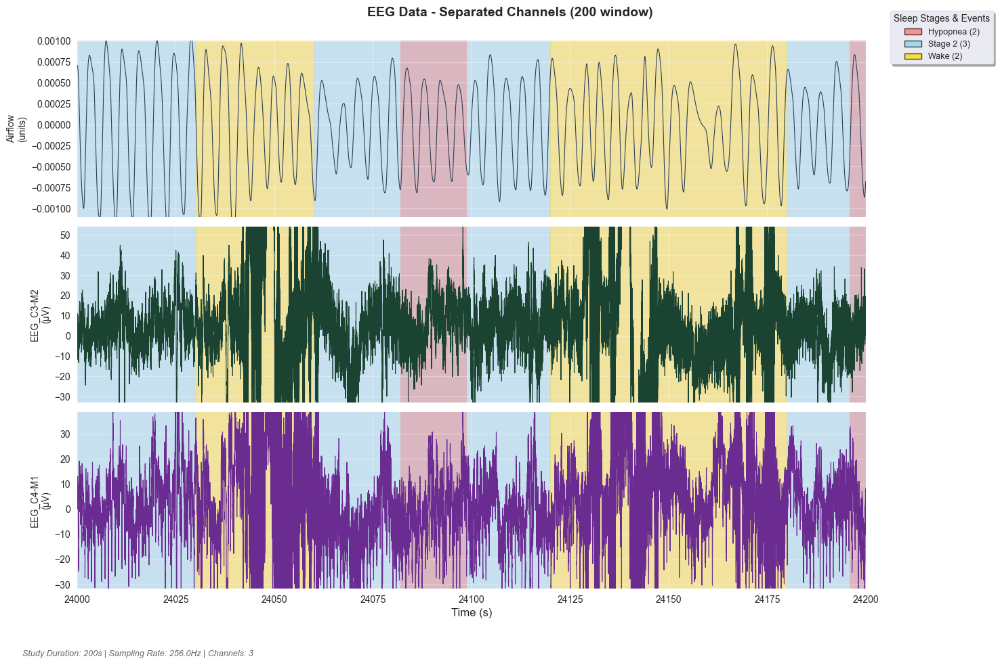

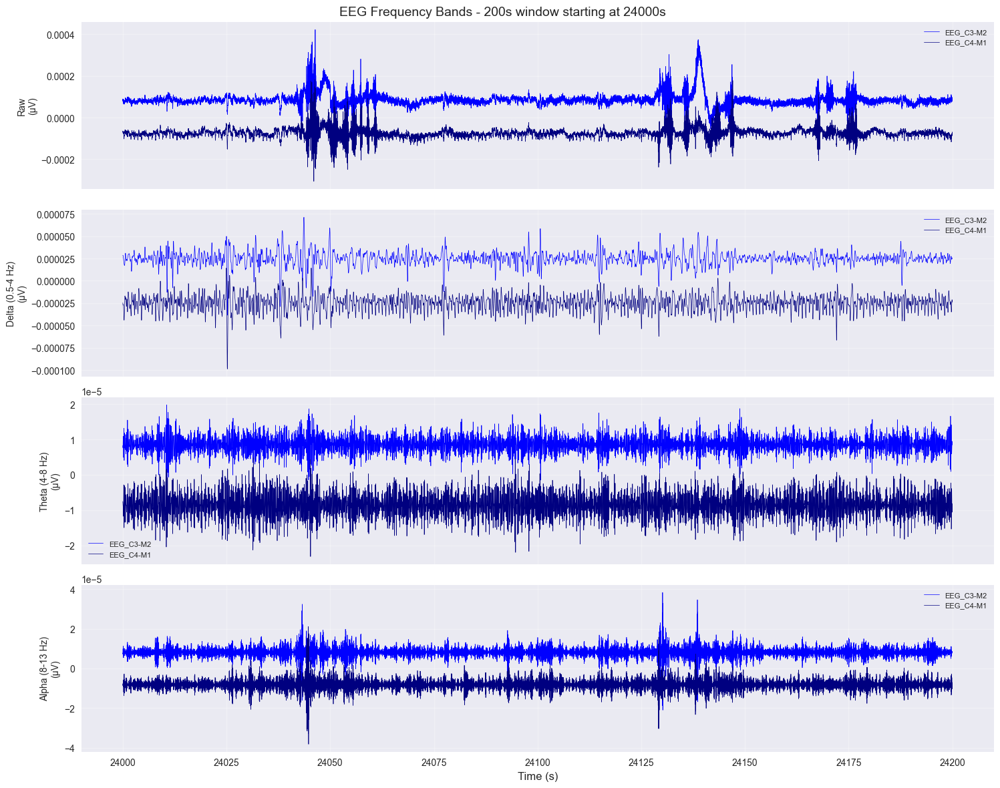

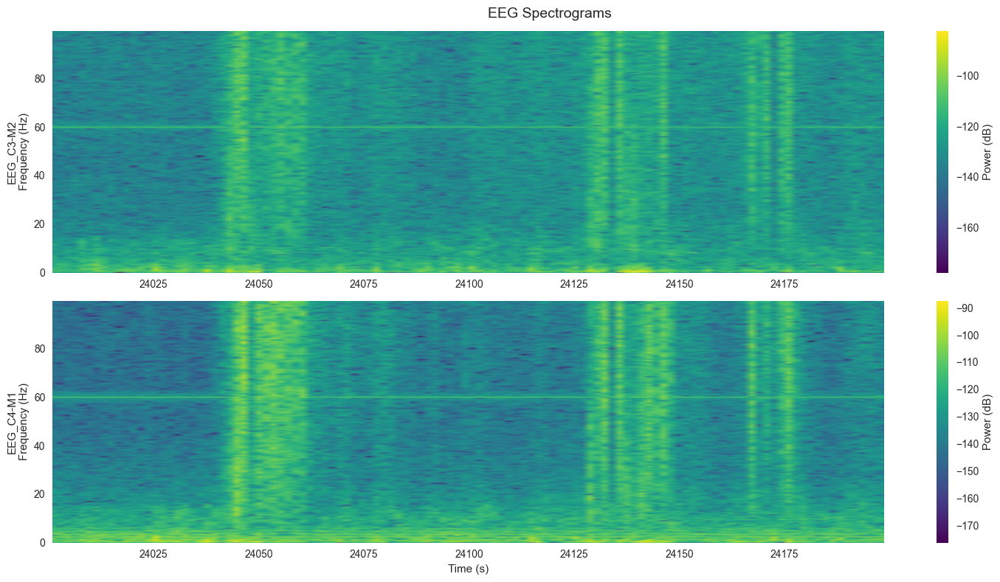

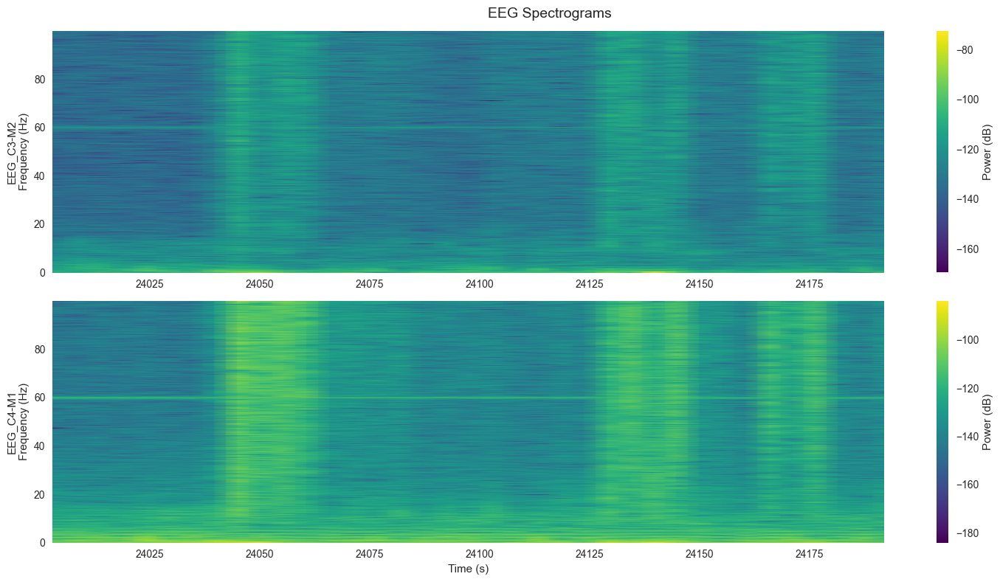

/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3154565061.py:111: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  axes[2].axvspan(plot_start, plot_end, alpha=0.3, color=background_color,



Annotations in time window 24000-24200:
23820.0-24030.0s: Stage 2
24030.0-24060.0s: Wake
24060.0-24120.0s: Stage 2
24082.0-24098.7s: Hypopnea w/ Arousal
24120.0-24180.0s: Wake
24180.0-26250.0s: Stage 2
24196.0-24209.3s: Hypopnea w/ Arousal


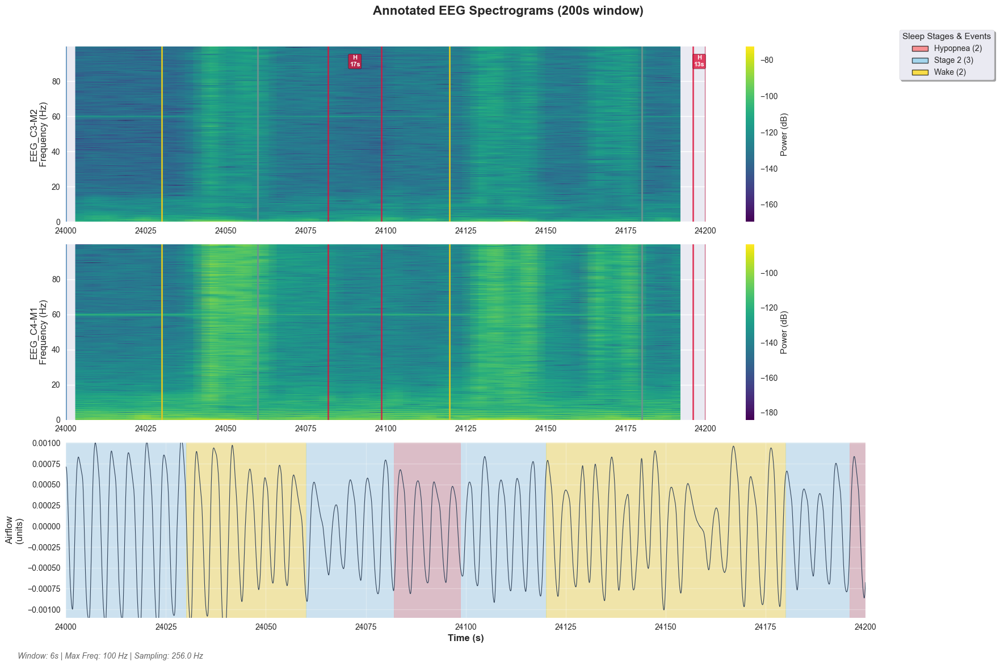

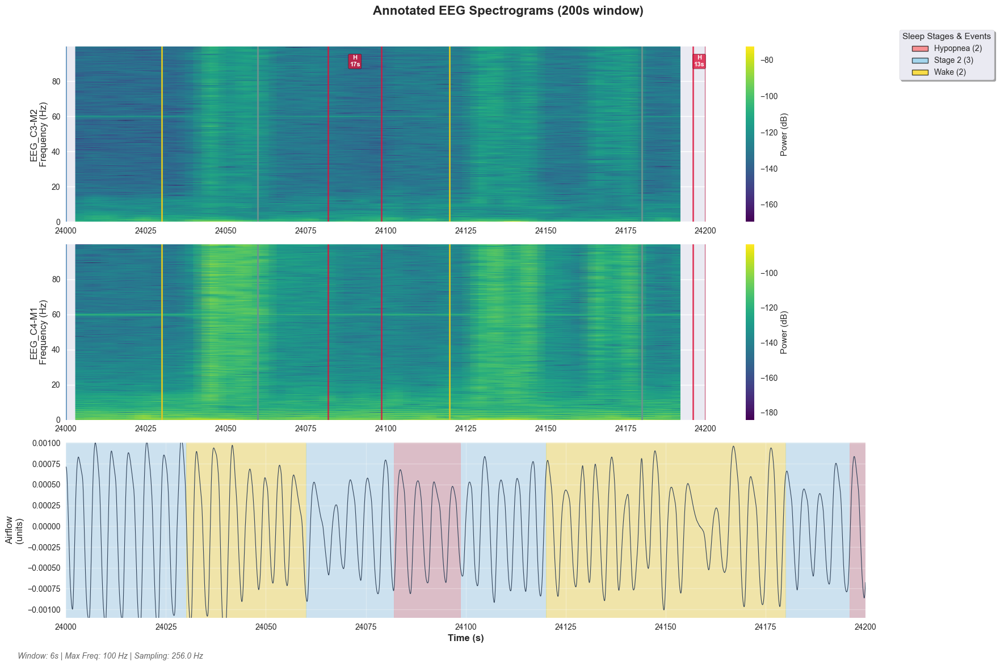

In [217]:
get_viz(24000,200,new_raw_nan)
plot_frequency_bands(new_raw_nan, start_time=24000, duration=200)
plot_spectrograms(new_raw_nan, start_time=24000, duration=200, signal_window=2, max_freq_hz=100)
plot_spectrograms(new_raw_nan, start_time=24000, duration=200, signal_window=6, max_freq_hz=100)
plot_annotated_spectrograms(new_raw_nan, start_time=24000, duration=200, signal_window=6, max_freq_hz=100)


/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/2062227179.py:90: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  ax.axvspan(plot_start, plot_end, alpha=0.35, color=color,


Annotations in time window 12000-12200:
9420.0-13470.0s: Wake


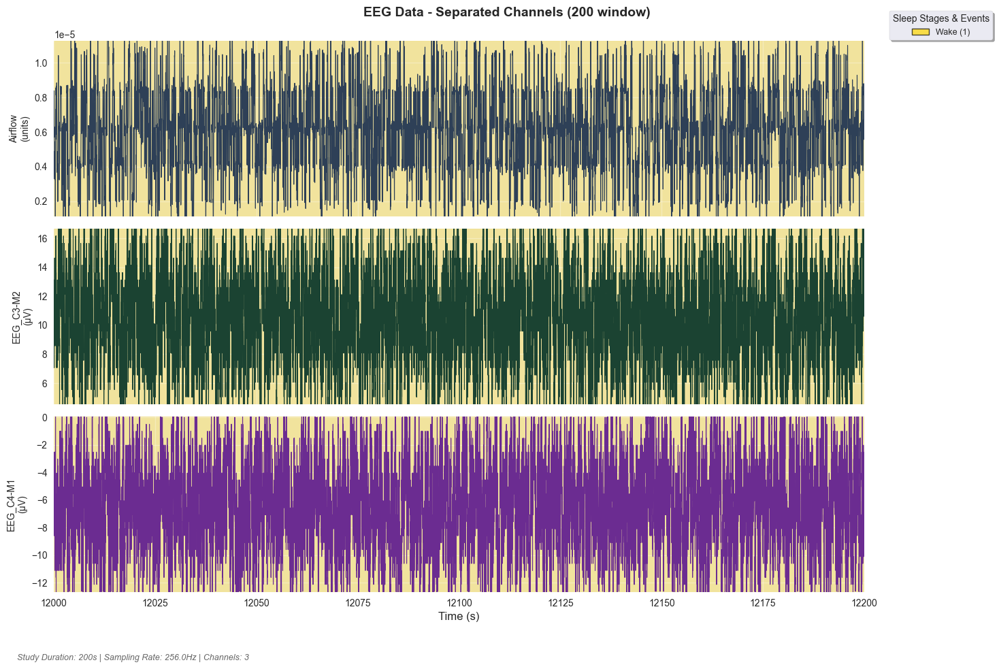

Annotations in time window 12000-12200:
9420.0-13470.0s: Wake


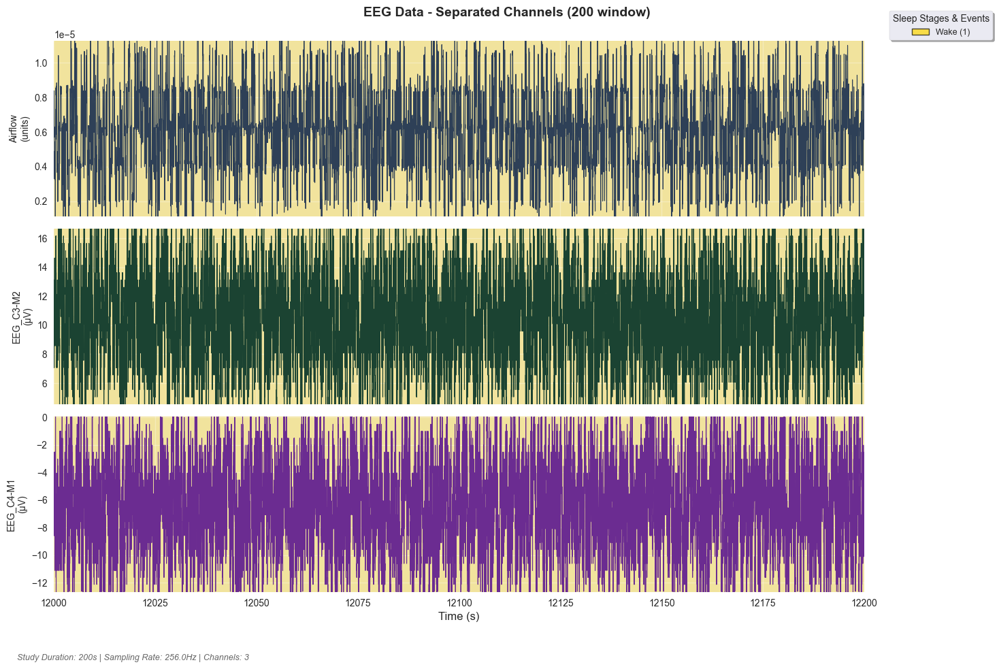

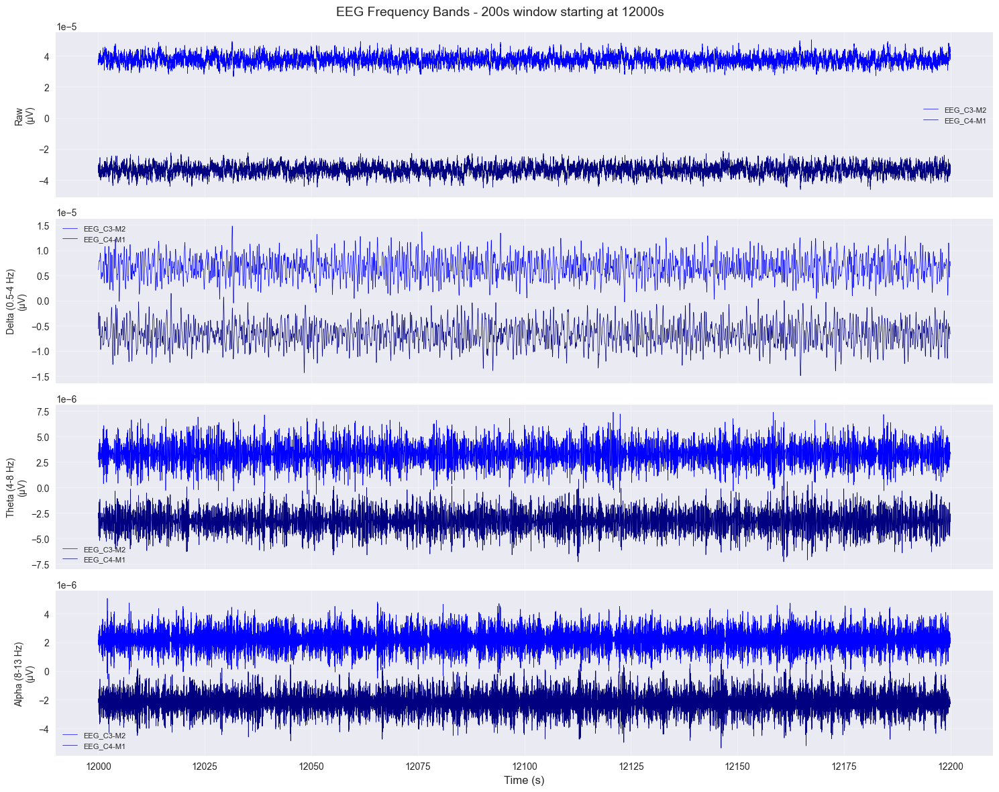

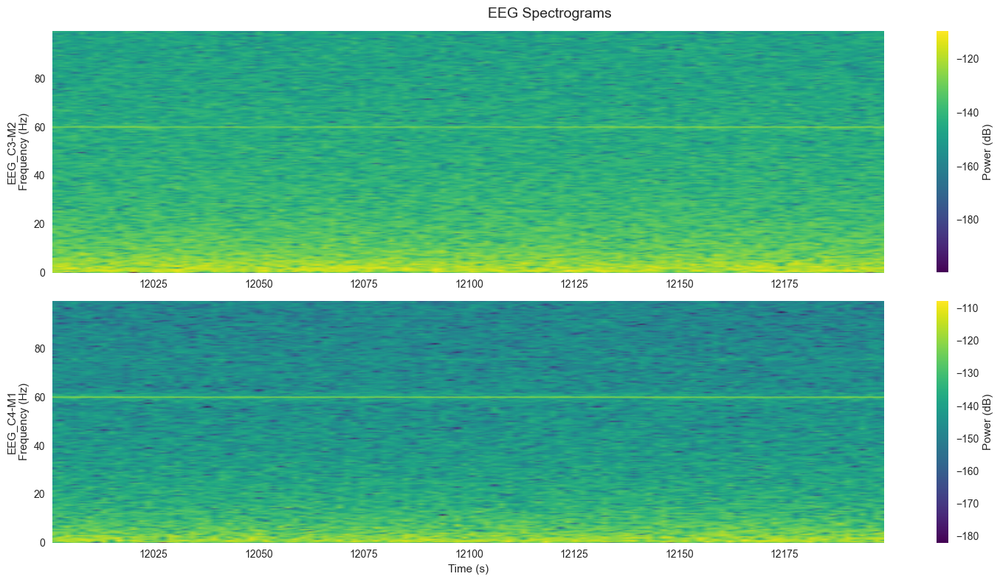

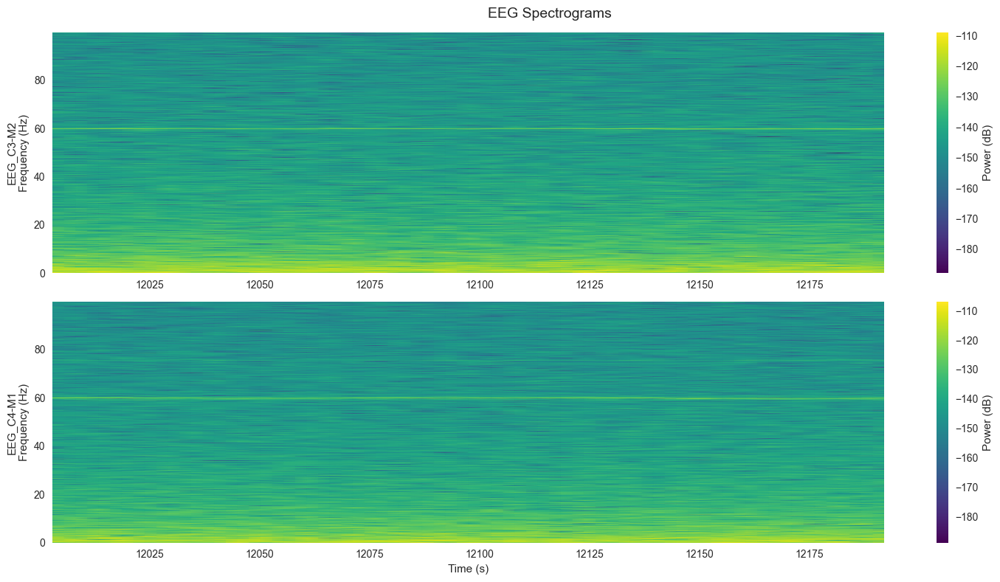

/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3154565061.py:111: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  axes[2].axvspan(plot_start, plot_end, alpha=0.3, color=background_color,



Annotations in time window 12000-12200:
9420.0-13470.0s: Wake


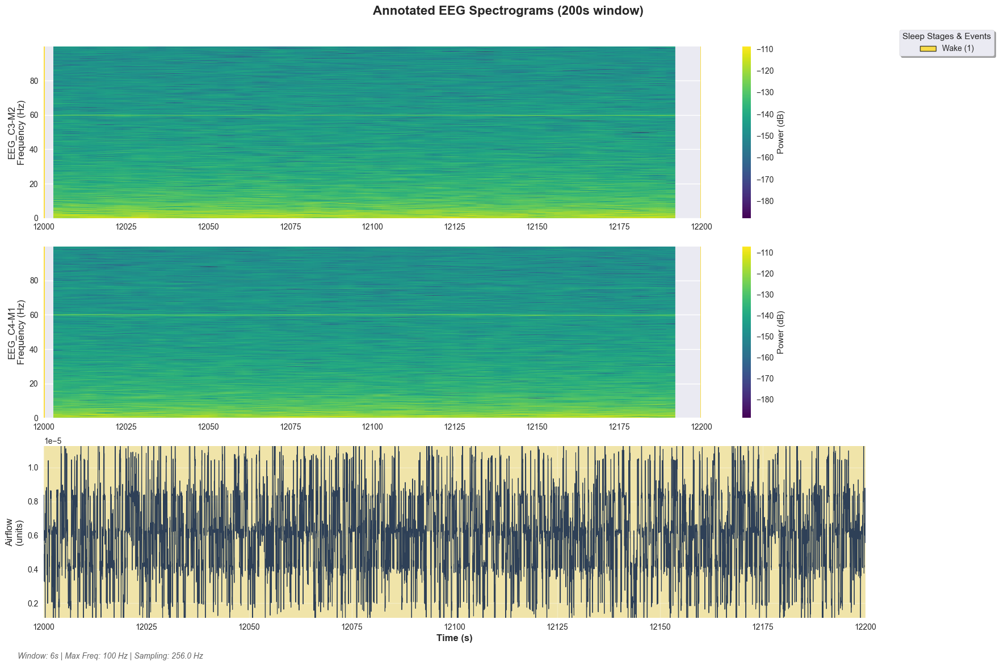

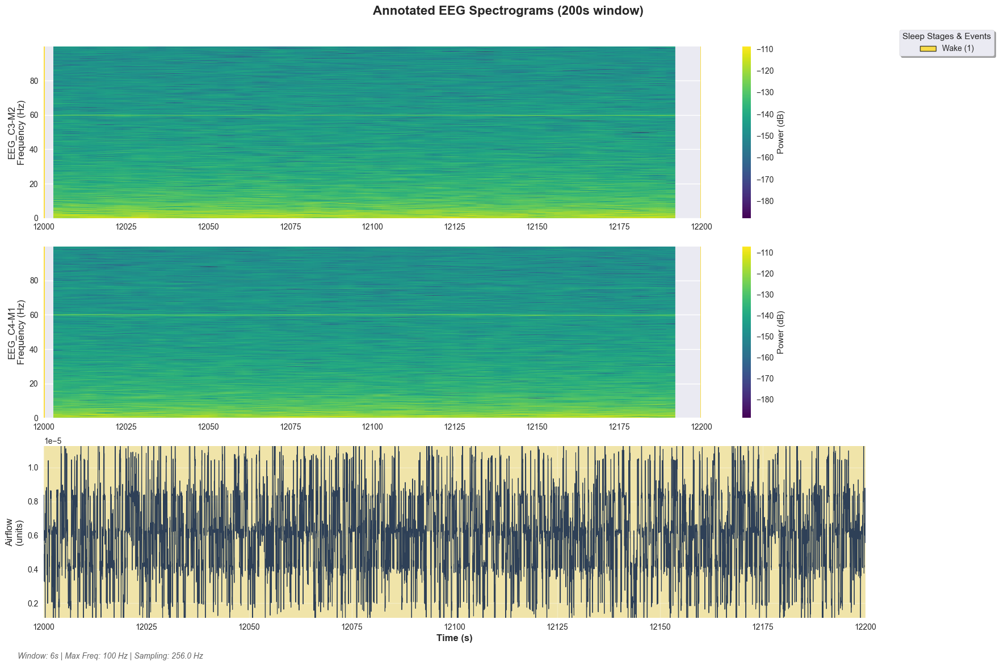

In [218]:
get_viz(12000,200,new_raw_nan)
get_viz(12000,200,new_raw_nan)
plot_frequency_bands(new_raw_nan, start_time=12000, duration=200)
plot_spectrograms(new_raw_nan, start_time=12000, duration=200, signal_window=2,max_freq_hz=100)
plot_spectrograms(new_raw_nan, start_time=12000, duration=200, signal_window=6,max_freq_hz=100)
plot_annotated_spectrograms(new_raw_nan, start_time=12000, duration=200, signal_window=6, max_freq_hz=100)


/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/2062227179.py:90: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  ax.axvspan(plot_start, plot_end, alpha=0.35, color=color,


Annotations in time window 16560-26560:
16560.0-17040.0s: Wake
17040.0-17100.0s: Stage 1
17100.0-17520.0s: Stage 2
17390.0-17403.8s: Hypopnea
17430.0-17445.6s: Hypopnea
17482.0-17501.5s: Hypopnea w/ Arousal
17520.0-19620.0s: Rem
17537.0-17575.9s: Hypopnea
17607.0-17658.1s: Hypopnea
17675.0-17739.7s: Hypopnea
17765.0-17799.2s: Hypopnea
17822.0-17835.3s: Hypopnea
17983.0-18013.6s: Hypopnea
18083.0-18099.7s: Hypopnea w/ Arousal
18117.0-18128.8s: Hypopnea
18161.0-18182.9s: Hypopnea
18351.0-18367.1s: Hypopnea
18418.0-18427.7s: Hypopnea
18648.0-18659.0s: Hypopnea
18687.0-18701.4s: Hypopnea w/ Arousal
18748.0-18758.7s: Hypopnea
18913.0-18925.5s: Hypopnea
19018.0-19029.4s: Hypopnea
19112.0-19130.1s: Hypopnea
19250.0-19264.6s: Hypopnea
19322.0-19335.3s: Hypopnea
19473.0-19489.3s: Hypopnea
19620.0-19920.0s: Stage 2
19659.0-19675.9s: Hypopnea
19920.0-19950.0s: Wake
19950.0-20040.0s: Stage 1
20040.0-21690.0s: Stage 2
20786.0-20809.0s: Hypopnea w/ Arousal
20998.0-21015.1s: Hypopnea
21589.0-21614.9s

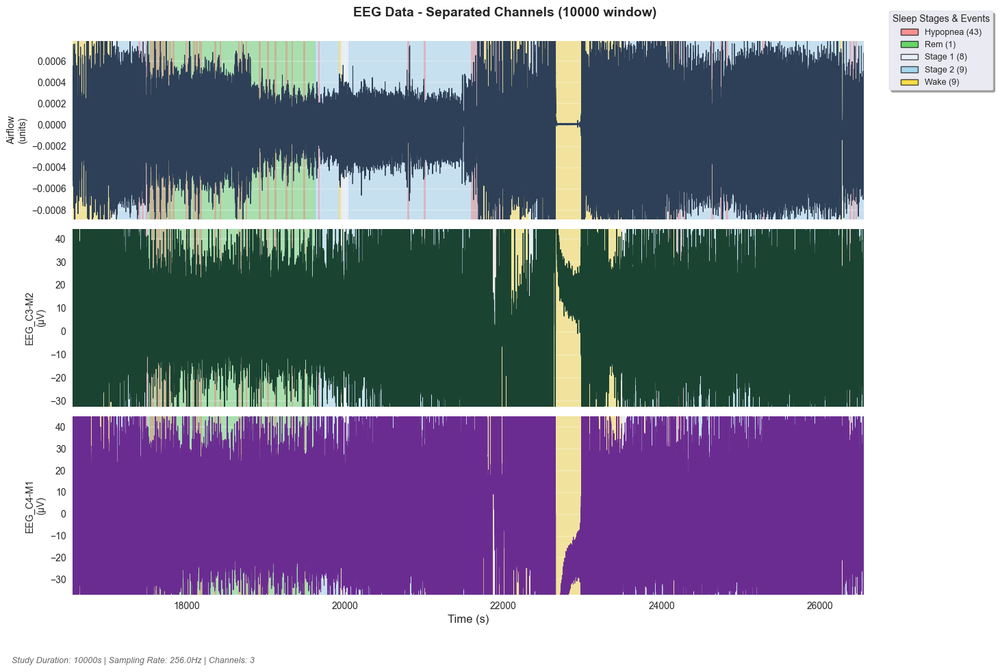

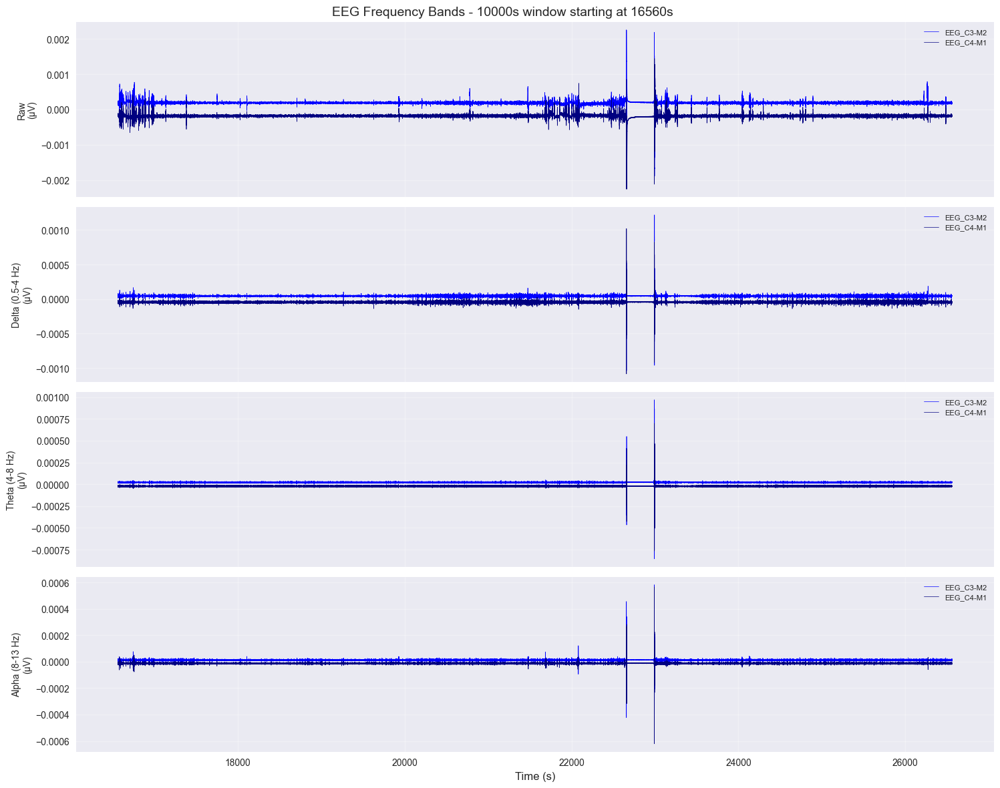

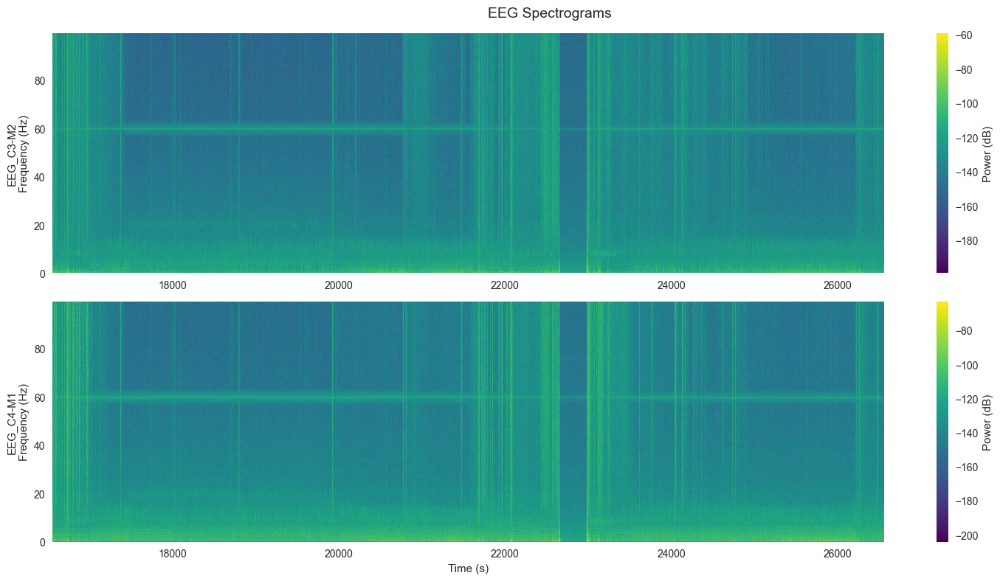

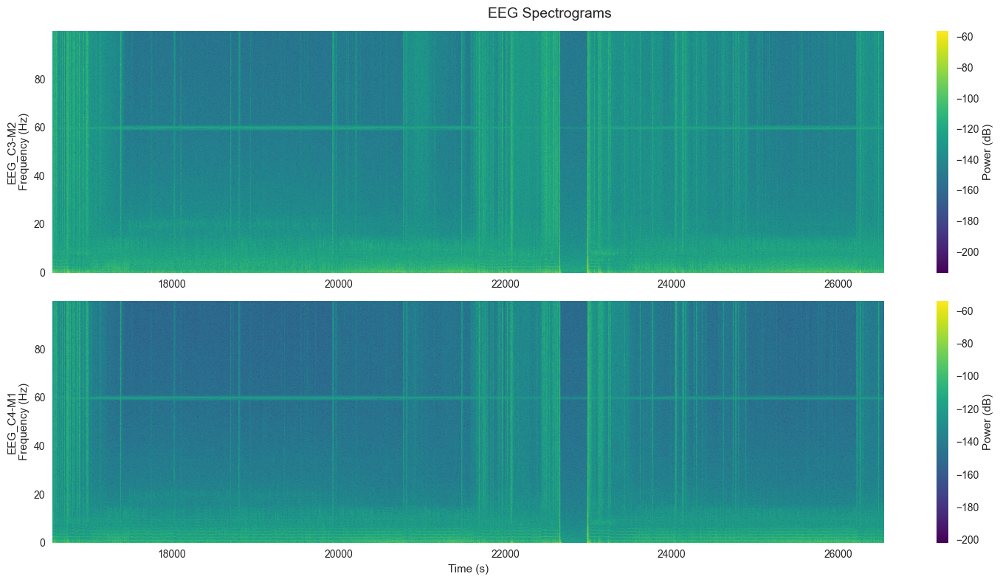

/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3154565061.py:111: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  axes[2].axvspan(plot_start, plot_end, alpha=0.3, color=background_color,



Annotations in time window 16560-26560:
16560.0-17040.0s: Wake
17040.0-17100.0s: Stage 1
17100.0-17520.0s: Stage 2
17390.0-17403.8s: Hypopnea
17430.0-17445.6s: Hypopnea
17482.0-17501.5s: Hypopnea w/ Arousal
17520.0-19620.0s: Rem
17537.0-17575.9s: Hypopnea
17607.0-17658.1s: Hypopnea
17675.0-17739.7s: Hypopnea
17765.0-17799.2s: Hypopnea
17822.0-17835.3s: Hypopnea
17983.0-18013.6s: Hypopnea
18083.0-18099.7s: Hypopnea w/ Arousal
18117.0-18128.8s: Hypopnea
18161.0-18182.9s: Hypopnea
18351.0-18367.1s: Hypopnea
18418.0-18427.7s: Hypopnea
18648.0-18659.0s: Hypopnea
18687.0-18701.4s: Hypopnea w/ Arousal
18748.0-18758.7s: Hypopnea
18913.0-18925.5s: Hypopnea
19018.0-19029.4s: Hypopnea
19112.0-19130.1s: Hypopnea
19250.0-19264.6s: Hypopnea
19322.0-19335.3s: Hypopnea
19473.0-19489.3s: Hypopnea
19620.0-19920.0s: Stage 2
19659.0-19675.9s: Hypopnea
19920.0-19950.0s: Wake
19950.0-20040.0s: Stage 1
20040.0-21690.0s: Stage 2
20786.0-20809.0s: Hypopnea w/ Arousal
20998.0-21015.1s: Hypopnea
21589.0-21614.9

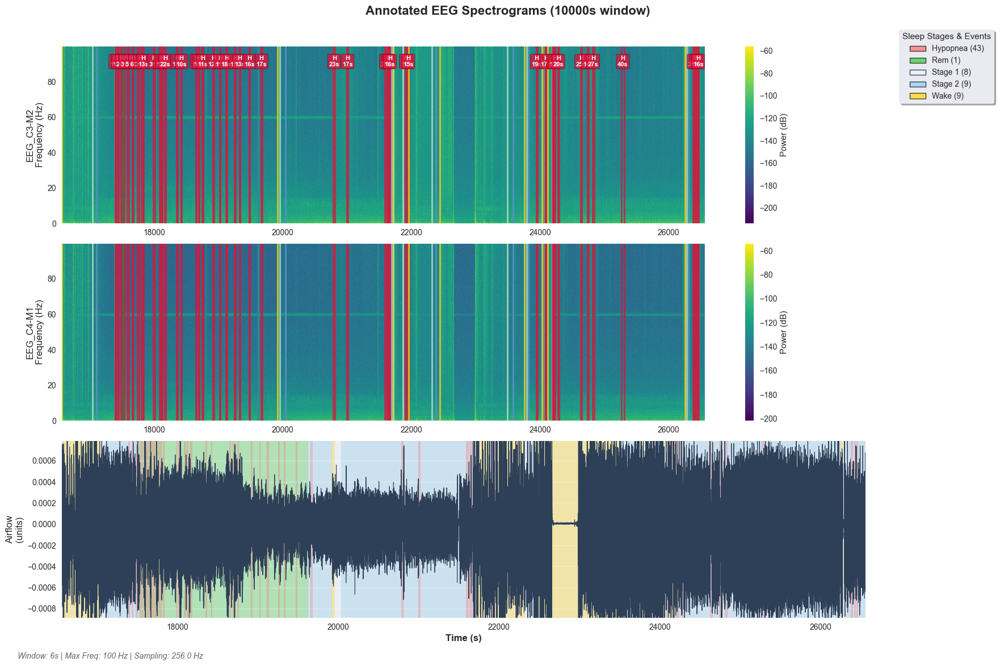

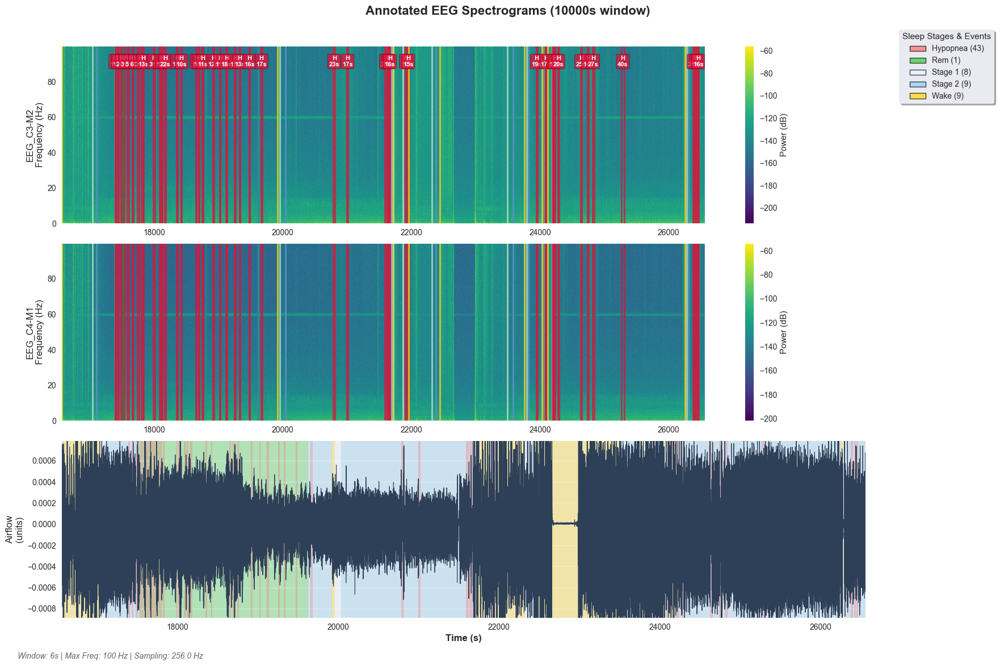

In [221]:
get_viz(16560,10000,new_raw_nan)
plot_frequency_bands(new_raw_nan, start_time=16560, duration=10000)

plot_spectrograms(new_raw_nan, start_time=16560,duration=10000, signal_window=2, max_freq_hz=100)
plot_spectrograms(new_raw_nan, start_time=16560,duration=10000, signal_window=6, max_freq_hz=100)

plot_annotated_spectrograms(new_raw_nan, 16560,10000, signal_window=6, max_freq_hz=100)


/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/2062227179.py:90: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  ax.axvspan(plot_start, plot_end, alpha=0.35, color=color,


Annotations in time window 17100-18100:
17100.0-17520.0s: Stage 2
17390.0-17403.8s: Hypopnea
17430.0-17445.6s: Hypopnea
17482.0-17501.5s: Hypopnea w/ Arousal
17520.0-19620.0s: Rem
17537.0-17575.9s: Hypopnea
17607.0-17658.1s: Hypopnea
17675.0-17739.7s: Hypopnea
17765.0-17799.2s: Hypopnea
17822.0-17835.3s: Hypopnea
17983.0-18013.6s: Hypopnea
18083.0-18099.7s: Hypopnea w/ Arousal


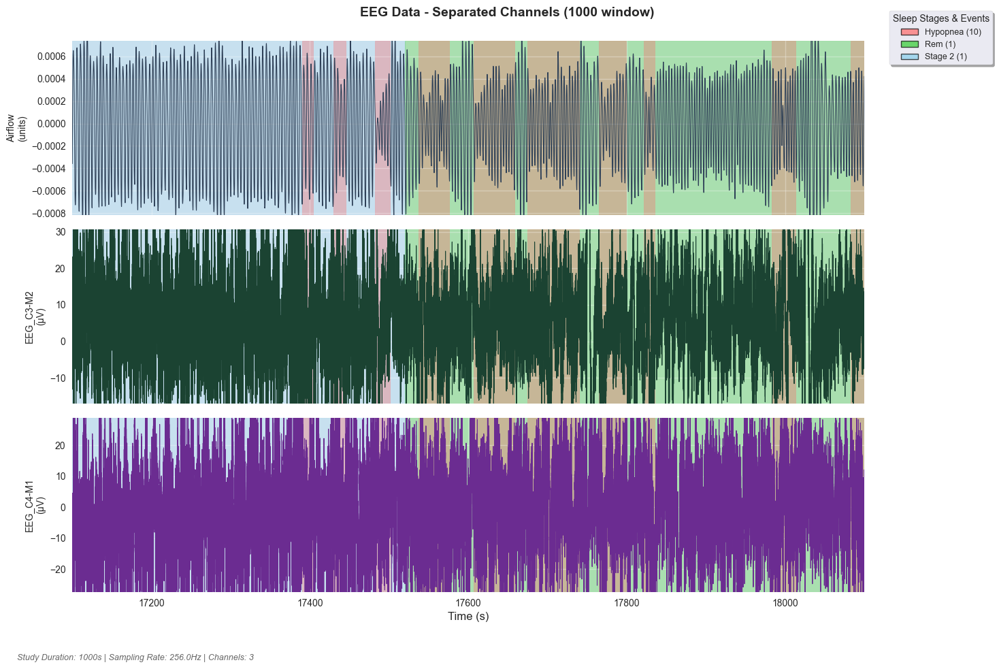

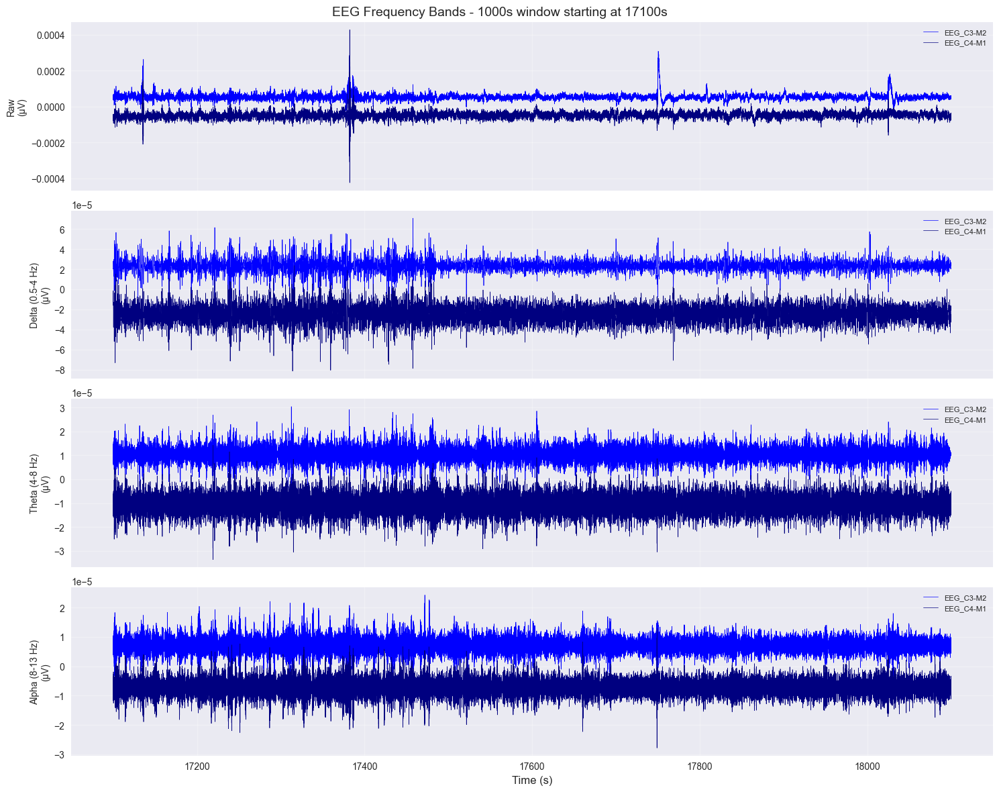

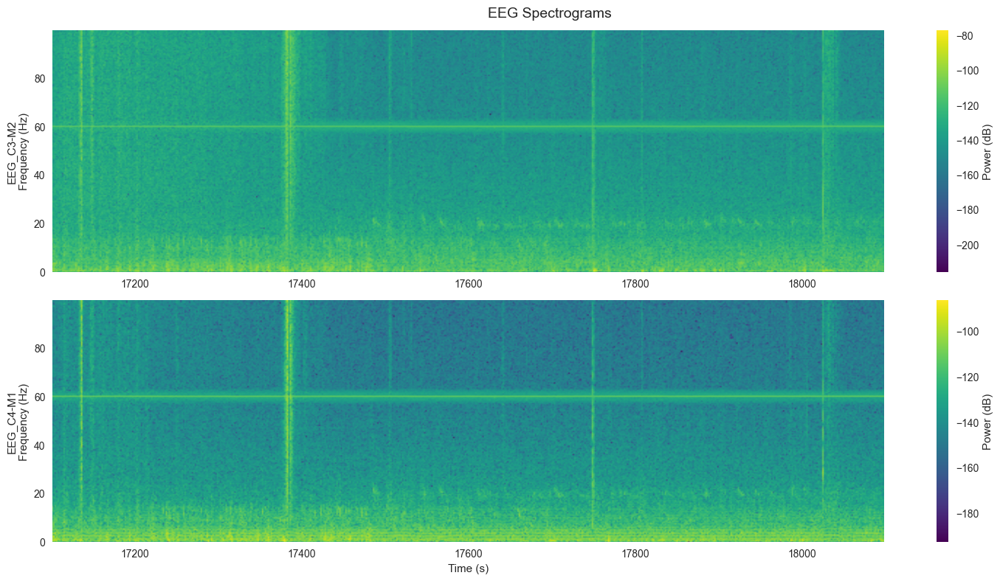

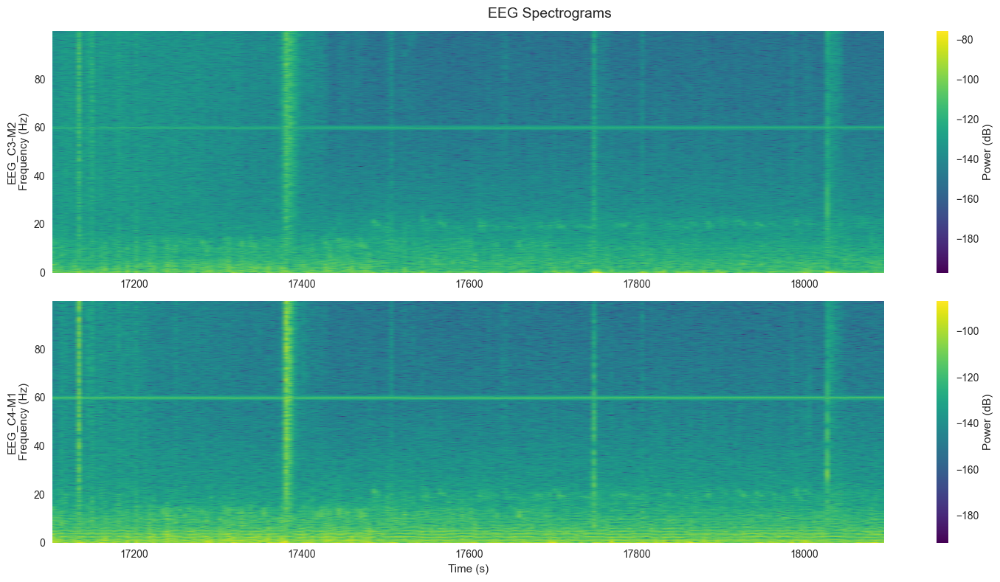

/var/folders/0g/5jl4b1d12lvc6g70prn2_rnr0000gn/T/ipykernel_808/3154565061.py:111: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  axes[2].axvspan(plot_start, plot_end, alpha=0.3, color=background_color,



Annotations in time window 17100-18100:
17100.0-17520.0s: Stage 2
17390.0-17403.8s: Hypopnea
17430.0-17445.6s: Hypopnea
17482.0-17501.5s: Hypopnea w/ Arousal
17520.0-19620.0s: Rem
17537.0-17575.9s: Hypopnea
17607.0-17658.1s: Hypopnea
17675.0-17739.7s: Hypopnea
17765.0-17799.2s: Hypopnea
17822.0-17835.3s: Hypopnea
17983.0-18013.6s: Hypopnea
18083.0-18099.7s: Hypopnea w/ Arousal


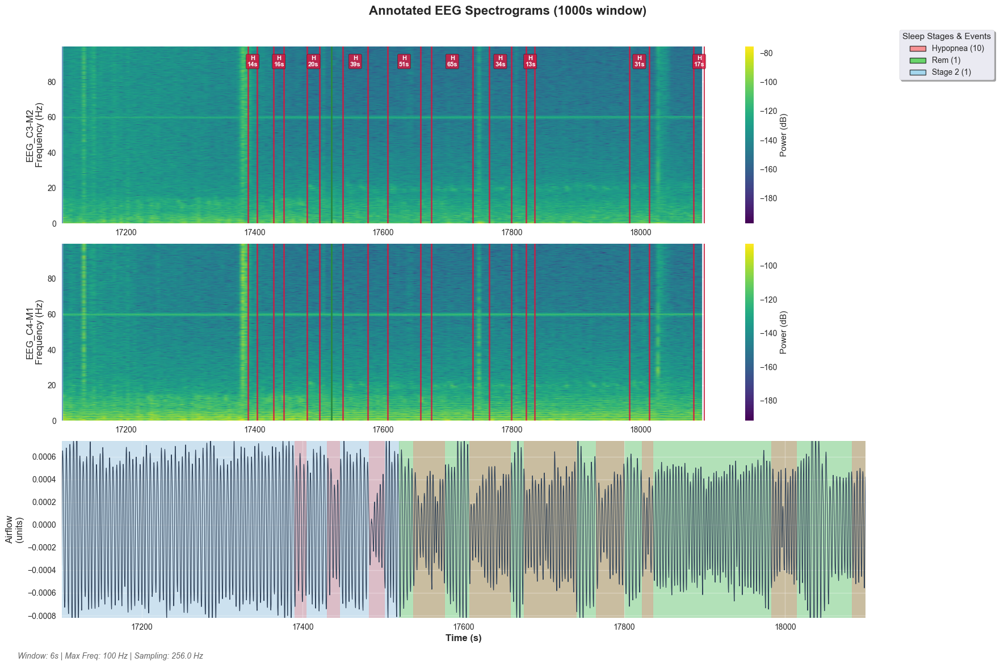

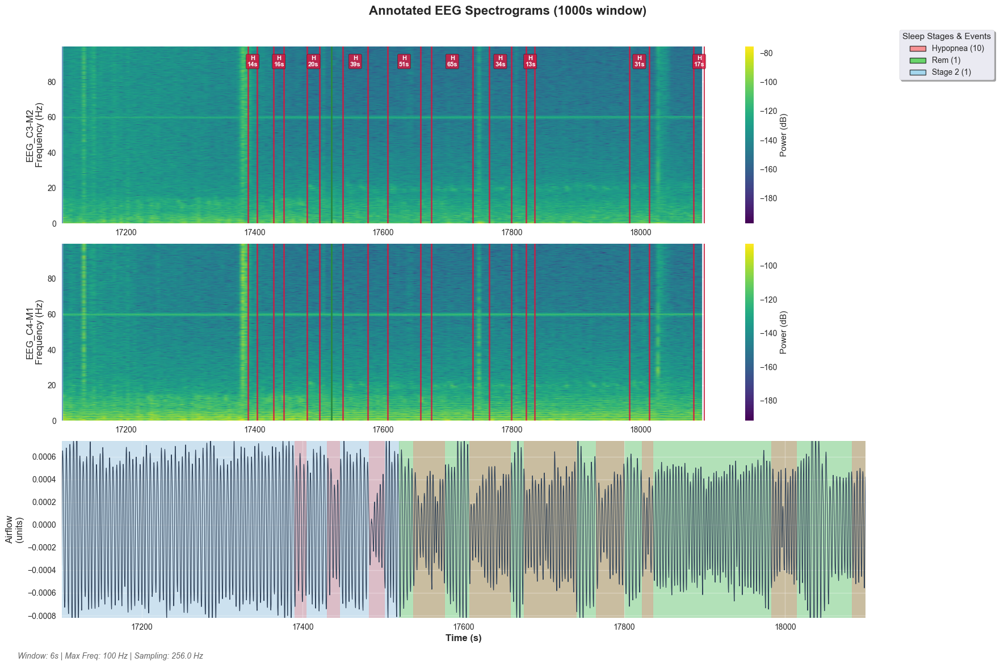

In [223]:

get_viz(17100,1000,new_raw_nan)
plot_frequency_bands(new_raw_nan, start_time=17100, duration=1000)

plot_spectrograms(new_raw_nan, start_time=17100,duration=1000, signal_window=2, max_freq_hz=100)
plot_spectrograms(new_raw_nan, start_time=17100,duration=1000, signal_window=6, max_freq_hz=100)

plot_annotated_spectrograms(new_raw_nan, 17100,1000, signal_window=6, max_freq_hz=100)


In [51]:
annotation_window_time(24120, 24240)

Annotations in time window: 24120 to 24240 seconds:
764: 24120.0s - 24180.0s ( 60.0s) Wake
765: 24150.0s - 24180.0s ( 30.0s) Wake
766: 24180.0s - 26250.0s (2070.0s) Stage 2
767: 24196.0s - 24209.3s ( 13.3s) Hypopnea w/ Arousal
768: 24210.0s - 24240.0s ( 30.0s) Stage 2
769: 24217.0s - 24234.4s ( 17.4s) Hypopnea
770: 24240.0s - 24270.0s ( 30.0s) Stage 2


In [45]:
# Check the actual range of your annotations
print(f"Annotation onset range: {new_raw.annotations.onset.min():.1f} to {new_raw.annotations.onset.max():.1f} seconds")
print(f"Number of annotations: {len(new_raw.annotations)}")
print(f"First 10 onsets: {new_raw.annotations.onset[:40]}")
print(f"First 10 onsets: {new_raw.annotations.description[:40]}")

Annotation onset range: 480.0 to 27150.0 seconds
Number of annotations: 877
First 10 onsets: [ 480.  510.  540.  570.  600.  630.  660.  690.  720.  750.  780.  810.
  840.  870.  900.  930.  960.  990. 1020. 1050. 1080. 1110. 1140. 1170.
 1200. 1230. 1260. 1290. 1320. 1350. 1380. 1410. 1440. 1470. 1500. 1530.
 1560. 1590. 1620. 1650.]
First 10 onsets: ['Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Stage 1']


In [46]:
print(f"Sleep stages DataFrame: {len(df_sleeping_stages)} rows")
print(f"Hypopnea DataFrame: {len(df_hypopnea)} rows")
print(f"Expected total annotations: {len(df_sleeping_stages) + len(df_hypopnea)}")
print(f"Actual annotations created: {len(new_raw.annotations)}")

Sleep stages DataFrame: 820 rows
Hypopnea DataFrame: 57 rows
Expected total annotations: 877
Actual annotations created: 877


In [ ]:
# Debug the annotation creation process
print(f"Sleep annotations created: {len(onsets_sleep)}")
print(f"Hypopnea annotations created: {len(onsets_hyp)}")

Sleep annotations created: 820
Hypopnea annotations created: 57


In [ ]:
all_durations_array = np.array(all_durations)
print(f"Duration range: {all_durations_array.min():.2f} to {all_durations_array.max():.2f}")
print(f"Negative durations: {(all_durations_array <= 0).sum()}")
print(f"NaN durations: {np.isnan(all_durations_array).sum()}")

Duration range: 9.28 to 4050.00
Negative durations: 0
NaN durations: 0


In [ ]:
print("First 10 annotation descriptions:")
print(new_raw.annotations.description)

First 10 annotation descriptions:
['Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Stage 1'
 'Stage 1' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Stage 1' 'Stage 1'
 'Stage 1' 'Stage 2' 'Stage 2' 'Stage 2' 'Hypopnea w/ Arousal' 'Stage 2'
 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2'
 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2'
 'Stage 2' 'Stage 2' 'Stage 2' 'Stage 2' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'Wake'
 'Wake' 'Wake' 'Wake' 'Wake' 'Wake' 'W

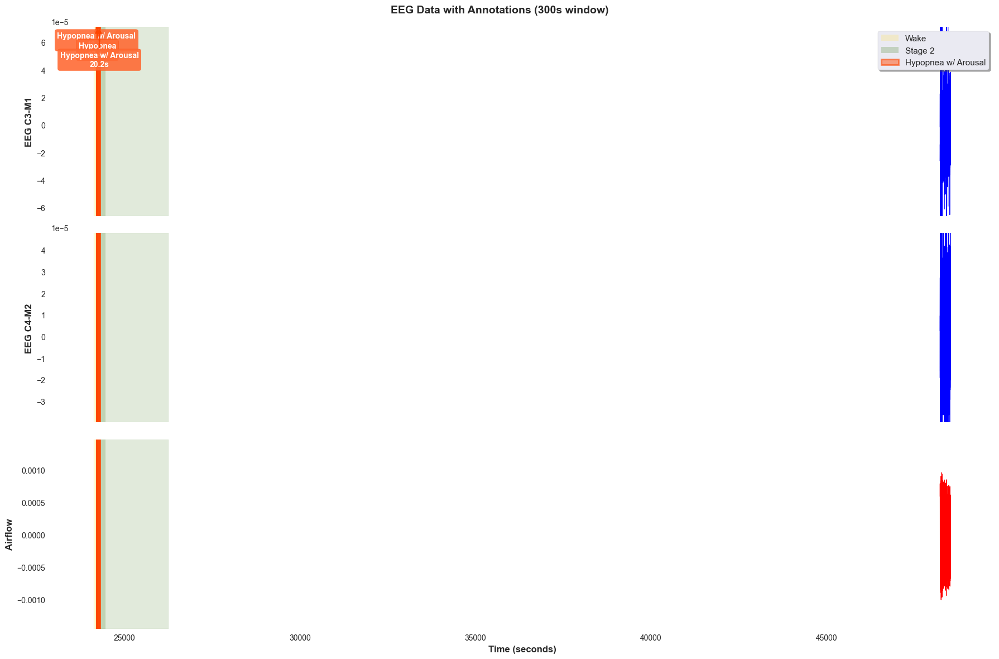

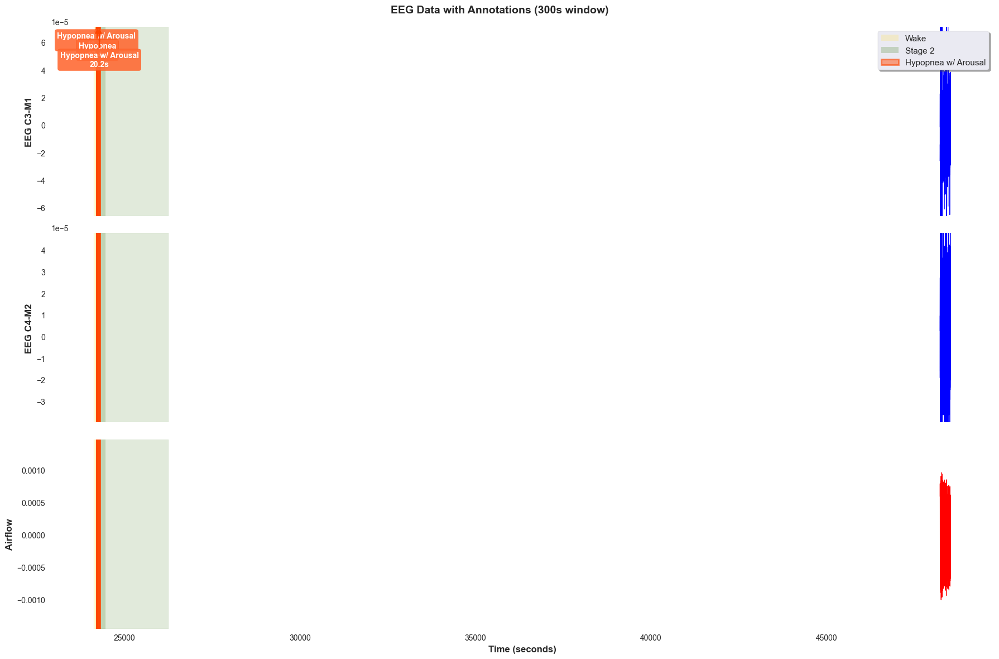

In [ ]:
# Alternative: Create custom plot from scratch
def create_enhanced_eeg_plot(start_time, duration_sec):
    """Create enhanced EEG plot with proper annotation handling"""
    
    # Get data for the time window
    start_sample = int(start_time * new_raw.info['sfreq'])
    end_sample = int((start_time + duration_sec) * new_raw.info['sfreq'])
    data, times = new_raw[:, start_sample:end_sample]
    times = times + start_time
    
    # Create the plot
    fig, axes = plt.subplots(3, 1, figsize=(18, 12), sharex=True)
    channel_names = ['EEG C3-M1', 'EEG C4-M2', 'Airflow']
    colors = ['blue', 'blue', 'red']  # Match MNE style
    
    # Plot each channel
    for i, (ch_data, ch_name, color) in enumerate(zip(data, channel_names, colors)):
        axes[i].plot(times, ch_data, color=color, linewidth=0.8)
        axes[i].set_ylabel(ch_name, fontsize=12, fontweight='bold')
        axes[i].grid(True, alpha=0.3)
        axes[i].set_facecolor('white')
        
        # Auto-scale like MNE
        mean_val = ch_data.mean()
        std_val = ch_data.std()
        axes[i].set_ylim(mean_val - 3*std_val, mean_val + 3*std_val)
    
    # Define annotation styling
    sleep_colors = {
        'Wake': ('#FFE66D', 0.2),
        'Stage 1': ('#A7C957', 0.2), 
        'Stage 2': ('#6A994E', 0.2),
        'Stage 3': ('#386641', 0.2),
        'REM': ('#BC4749', 0.2)
    }
    
    # Process annotations
    sleep_annotations = []
    hypopnea_annotations = []
    
    for onset, dur, desc in zip(new_raw.annotations.onset, new_raw.annotations.duration, new_raw.annotations.description):
        if start_time <= onset <= start_time + duration_sec:
            if 'Hypopnea' in desc:
                hypopnea_annotations.append((onset, dur, desc))
            elif desc in sleep_colors:
                sleep_annotations.append((onset, dur, desc))
    
    # Add sleep stage backgrounds
    legend_items = []
    for onset, dur, desc in sleep_annotations:
        color, alpha = sleep_colors[desc]
        for i in range(3):
            axes[i].axvspan(onset, onset + dur, alpha=alpha, color=color, zorder=1)
        
        # Add to legend only once
        if desc not in [item[1] for item in legend_items]:
            legend_items.append(('sleep', desc, color))
    
    # Add hypopnea events with borders and labels
    for idx, (onset, dur, desc) in enumerate(hypopnea_annotations):
        # Highlight on all channels
        for i in range(3):
            # Main colored area
            axes[i].axvspan(onset, onset + dur, alpha=0.6, color='#FF6B35', zorder=5)
            
            # Border lines
            axes[i].axvline(onset, color='#FF4500', linewidth=2, alpha=0.9, zorder=6)
            axes[i].axvline(onset + dur, color='#FF4500', linewidth=2, alpha=0.9, zorder=6)
        
        # Add duration label on top subplot
        label_y_positions = [0.95, 0.85, 0.75]
        label_y = label_y_positions[idx % len(label_y_positions)]
        
        axes[0].annotate(f'{desc}\n{dur:.1f}s', 
                        xy=(onset + dur/2, axes[0].get_ylim()[1]), 
                        xytext=(onset + dur/2, axes[0].get_ylim()[1] * label_y),
                        ha='center', va='top',
                        bbox=dict(boxstyle="round,pad=0.3", facecolor='#FF6B35', 
                                 edgecolor='#FF4500', alpha=0.9),
                        fontsize=10, fontweight='bold', color='white',
                        arrowprops=dict(arrowstyle='->', color='#FF4500', lw=2),
                        zorder=10)
    
    # Add hypopnea to legend
    if hypopnea_annotations:
        legend_items.append(('hypopnea', 'Hypopnea w/ Arousal', '#FF6B35'))
    
    # Create legend
    if legend_items:
        legend_handles = []
        for item_type, desc, color in legend_items:
            if item_type == 'hypopnea':
                handle = plt.Rectangle((0,0),1,1, facecolor=color, edgecolor='#FF4500', 
                                     linewidth=2, alpha=0.6)
            else:
                handle = plt.Rectangle((0,0),1,1, facecolor=color, alpha=0.3)
            legend_handles.append((handle, desc))
        
        handles, labels = zip(*legend_handles)
        axes[0].legend(handles, labels, loc='upper right', frameon=True, 
                      fancybox=True, shadow=True, fontsize=11)
    
    # Formatting
    axes[2].set_xlabel('Time (seconds)', fontsize=12, fontweight='bold')
    plt.suptitle(f'EEG Data with Annotations ({duration_sec}s window)', 
                fontsize=14, fontweight='bold')
    
    plt.tight_layout()
    plt.show()
    
    return fig

# Use the custom function
create_enhanced_eeg_plot(24120, 300)

Plotting from first annotation at 24120 seconds


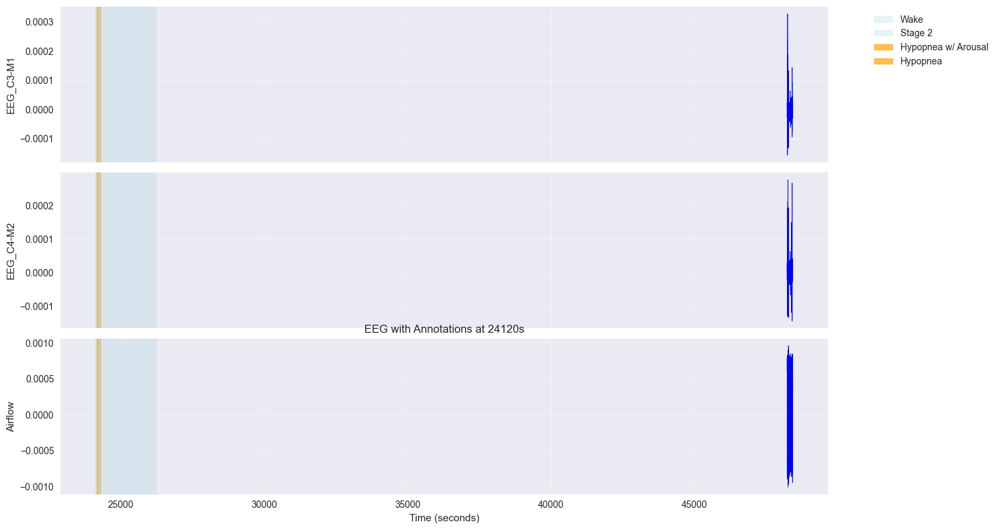

In [ ]:
# Use the first annotation's location instead
first_annotation_time = 24120
start_time = int(first_annotation_time)
duration = 200  # 2 minutes

print(f"Plotting from first annotation at {start_time} seconds")

# Get data for the time window
data, times = new_raw[:, int(start_time * new_raw.info['sfreq']):int((start_time + duration) * new_raw.info['sfreq'])]
times = times + start_time

# Plot
fig, axes = plt.subplots(3, 1, figsize=(15, 8), sharex=True)
channel_names = ['EEG_C3-M1', 'EEG_C4-M2', 'Airflow']

for i, (ch_data, ch_name) in enumerate(zip(data, channel_names)):
    axes[i].plot(times, ch_data, 'b-', linewidth=0.5)
    axes[i].set_ylabel(ch_name)
    axes[i].grid(True, alpha=0.3)

# Add annotation bars
added_labels = set()
for onset, duration_ann, description in zip(new_raw.annotations.onset, 
                                           new_raw.annotations.duration, 
                                           new_raw.annotations.description):
    if start_time <= onset <= start_time + duration:
        color = 'orange' if 'Hypopnea' in description else 'lightblue'
        alpha = 0.7 if 'Hypopnea' in description else 0.3
        
        for i in range(3):
            label = description if (description not in added_labels and i == 0) else ""
            axes[i].axvspan(onset, onset + duration_ann, alpha=alpha, 
                          color=color, label=label)
            if label:
                added_labels.add(description)

axes[2].set_xlabel('Time (seconds)')
if added_labels:
    axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.title(f'EEG with Annotations at {start_time}s')
plt.show()

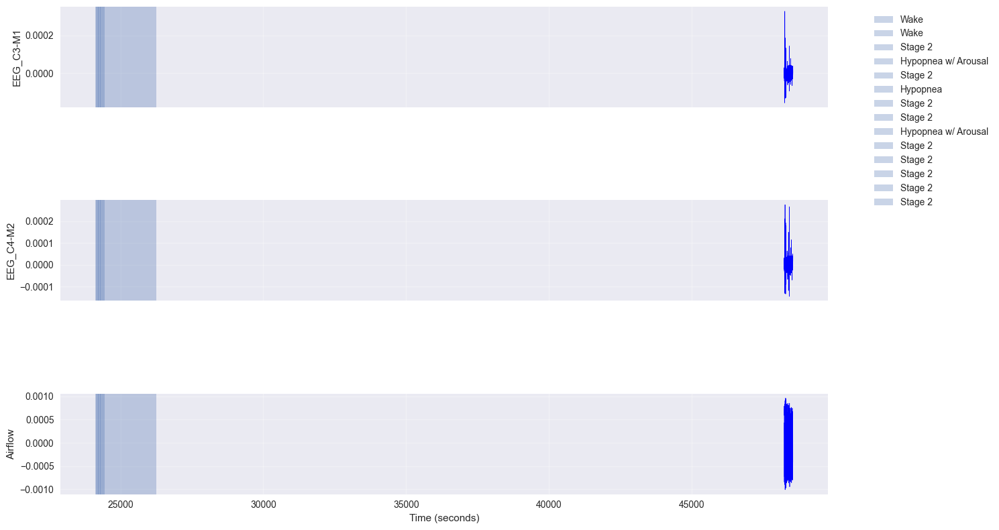

In [76]:
import matplotlib.pyplot as plt

# Create a time window where annotations exist
start_time = 24120  # seconds
duration = 300    # 5 minutes

# Get data for the time window
data, times = new_raw[:, int(start_time * new_raw.info['sfreq']):int((start_time + duration) * new_raw.info['sfreq'])]
times = times + start_time

# Plot
fig, axes = plt.subplots(3, 1, figsize=(15, 8), sharex=True)
channel_names = ['EEG_C3-M1', 'EEG_C4-M2', 'Airflow']

for i, (ch_data, ch_name) in enumerate(zip(data, channel_names)):
    axes[i].plot(times, ch_data, 'b-', linewidth=0.5)
    axes[i].set_ylabel(ch_name)
    axes[i].grid(True, alpha=0.3)

# Add annotation bars
for onset, duration_ann, description in zip(new_raw.annotations.onset, 
                                           new_raw.annotations.duration, 
                                           new_raw.annotations.description):
    if start_time <= onset <= start_time + duration:
        for i in range(3):
            axes[i].axvspan(onset, onset + duration_ann, alpha=0.3, 
                          label=description if i == 0 else "")

axes[2].set_xlabel('Time (seconds)')
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()